In [1]:
import pandas as pd
from scipy import stats
import numpy as np
import scipy
import matplotlib.pyplot as plt
import seaborn as sns
%matplotlib inline
import datetime
import plotly
import plotly.graph_objs as go
from plotly.subplots import make_subplots
import plotly.express as px
import warnings
warnings.filterwarnings('ignore') 

In [2]:
import statsmodels.formula.api as sm
from sklearn.compose import ColumnTransformer
from sklearn.pipeline import Pipeline
from sklearn.preprocessing import OneHotEncoder
from sklearn.preprocessing import StandardScaler
from sklearn.preprocessing import MinMaxScaler
from sklearn.impute import SimpleImputer
from sklearn.preprocessing import FunctionTransformer
from sklearn.model_selection import train_test_split
from sklearn import preprocessing
from sklearn import tree
from sklearn.model_selection import cross_val_score

In [3]:
# Import Regressor
from sklearn.ensemble import RandomForestRegressor
from sklearn.linear_model import LinearRegression
from sklearn.linear_model import LinearRegression,Lasso,Ridge,ElasticNet
from sklearn.tree import DecisionTreeRegressor
from sklearn.ensemble import AdaBoostRegressor
from sklearn.svm import SVR
# import xgboost as xgb
from sklearn.linear_model import BayesianRidge
from sklearn.neighbors import KNeighborsRegressor
from sklearn.ensemble import ExtraTreesRegressor

#import the metrics
from sklearn.metrics import mean_squared_error, mean_absolute_error, r2_score

In [5]:
# Read the dataset
# https://docs.google.com/spreadsheets/d/1XfowzShji-7VJCpBEBHUuRBZfpN9GYFIWUGvjyPzUdE/edit#gid=1303727063

df = pd.read_excel("../datasets/precipitation_intervention_cases.xlsx")

In [6]:
df.head()

,date,district_PCODE,rfh,rfh_avg,r1h,r1h_avg,r3h,r3h_avg,rfq,r1q,...,County,county_PCODE,district_area_SQKM,IRS_coverage_per_100_household,itn_access_per_100_people,itn_use_per_100_people,itn_userate_in_people_with_access,effective_treatment_per_100_cases,Cases_Value,Deaths_Value
0,2010-01-01,LR0713,21.4,15.0667,64.4,79.7000,544.6,577.4067,131.5615,82.9431,...,Grand Kru,LR07,182.722183,1.148695,71.745426,70.246698,97.491393,57.379744,32106.21812,126.676347
1,2010-01-11,LR0713,13.2,13.1533,53.4,60.1867,542.2,481.4067,100.2571,90.3305,...,Grand Kru,LR07,182.722183,1.148695,71.745426,70.246698,97.491393,57.379744,32106.21812,126.676347
2,2010-01-21,LR0713,15.8,13.7400,50.4,41.9600,462.8,371.2467,110.9925,116.2433,...,Grand Kru,LR07,182.722183,1.148695,71.745426,70.246698,97.491393,57.379744,32106.21812,126.676347
3,2010-02-01,LR0713,16.2,30.4933,45.2,57.3867,298.0,327.2000,59.7295,81.9153,...,Grand Kru,LR07,182.722183,1.148695,71.745426,70.246698,97.491393,57.379744,32106.21812,126.676347
4,2010-02-11,LR0713,84.6,40.9400,116.6,85.1733,271.8,294.9600,195.0370,133.0205,...,Grand Kru,LR07,182.722183,1.148695,71.745426,70.246698,97.491393,57.379744,32106.21812,126.676347


In [7]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 53460 entries, 0 to 53459
Data columns (total 25 columns):
 #   Column                             Non-Null Count  Dtype         
---  ------                             --------------  -----         
 0   date                               53460 non-null  datetime64[ns]
 1   district_PCODE                     53460 non-null  object        
 2   rfh                                53460 non-null  float64       
 3   rfh_avg                            53460 non-null  float64       
 4   r1h                                53460 non-null  float64       
 5   r1h_avg                            53460 non-null  float64       
 6   r3h                                53460 non-null  float64       
 7   r3h_avg                            53460 non-null  float64       
 8   rfq                                53460 non-null  float64       
 9   r1q                                53460 non-null  float64       
 10  r3q                               

In [7]:
df.shape

(53460, 25)

In [8]:
df.describe().T

,count,mean,min,25%,50%,75%,max,std
date,53460,2015-06-26 19:38:10.909090816,2010-01-01 00:00:00,2012-09-28 12:00:00,2015-06-26 00:00:00,2018-03-23 18:00:00,2020-12-21 00:00:00,NaN
rfh,53460.0,72.399973,1.0,26.566325,57.7951,103.25,593.875,60.642147
rfh_avg,53460.0,71.53709,2.6241,34.395975,64.97415,101.4977,310.3611,48.225441
r1h,53460.0,217.103384,3.6111,95.2857,190.3693,310.780725,1138.0,154.086316
r1h_avg,53460.0,214.61127,9.9848,105.321275,195.6417,304.861525,812.2667,136.514959
r3h,53460.0,651.706591,36.6111,353.19545,630.8236,893.2923,2583.8333,366.751896
r3h_avg,53460.0,643.833812,68.5621,348.870025,650.9245,868.772225,2009.8778,342.208321
rfq,53460.0,100.428744,7.5908,71.042575,95.07815,120.933575,445.5492,44.194491
r1q,53460.0,100.168752,21.9787,81.38225,98.01935,115.362975,341.5034,29.467277
r3q,53460.0,100.992567,37.8174,87.853725,99.6033,112.1811,197.6945,19.717192


In [9]:
print(df.select_dtypes(include=['object']).columns)

Index(['district_PCODE', 'version', 'District', 'County', 'county_PCODE'], dtype='object')


In [10]:
# Value counts for each categorical feature: 

for column in df.select_dtypes(include=['object']):
    print(f"Value counts for {column}:")
    print(df[column].value_counts())
    print(df[column].nunique())
    print()
    print("="*45)

Value counts for district_PCODE:
district_PCODE
LR0713    396
LR1207    396
LR1504    396
LR0101    396
LR0705    396
         ... 
LR1514    396
LR1515    396
LR1309    396
LR1516    396
LR1214    396
Name: count, Length: 135, dtype: int64
135

Value counts for version:
version
final    53460
Name: count, dtype: int64
1

Value counts for District:
District
Kpi                396
Gbor               396
Dugbe River        396
Dowein             396
Dorbor             396
                  ... 
Sanquin Dist #3    396
Sanquin Dist #2    396
Sarbo              396
Seekon             396
Yarmein            396
Name: count, Length: 135, dtype: int64
135

Value counts for County:
County
Grand Kru           7128
Sinoe               6732
Nimba               6732
Bong                4752
River Gee           3960
Rivercess           3168
Grand Gedeh         3168
Grand Bassa         2772
Lofa                2772
Maryland            2772
Gbarpolu            2376
Montserrado         1980
Grand Cape 

In [8]:
# Drop "version","county_PCODE","district_PCODE" columns:

df=df.drop(["version","county_PCODE","district_PCODE"], axis=1)

# Univariate Analysis - Histogram Plots

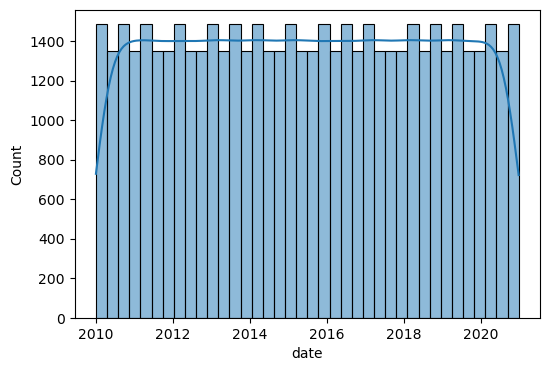

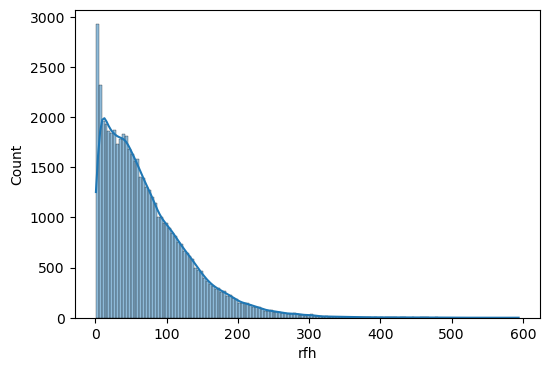

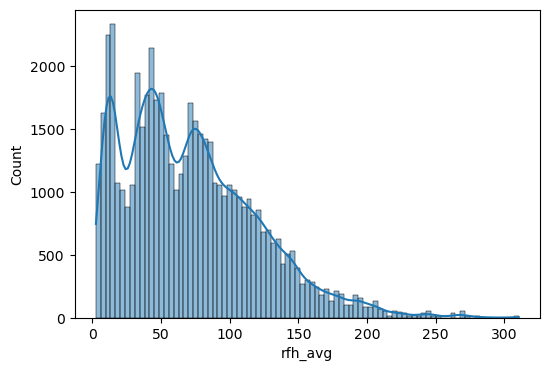

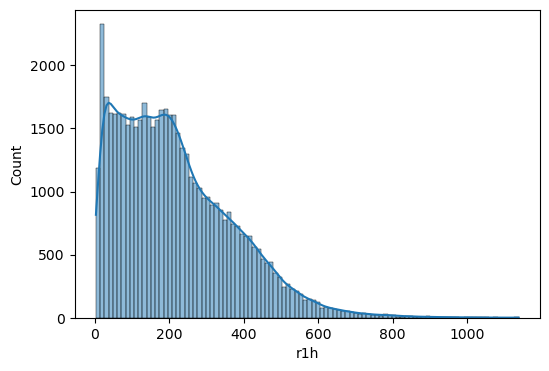

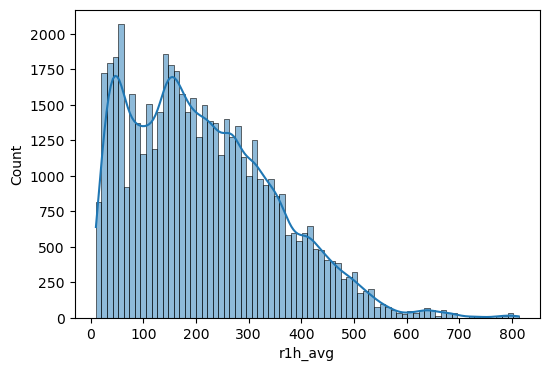

...

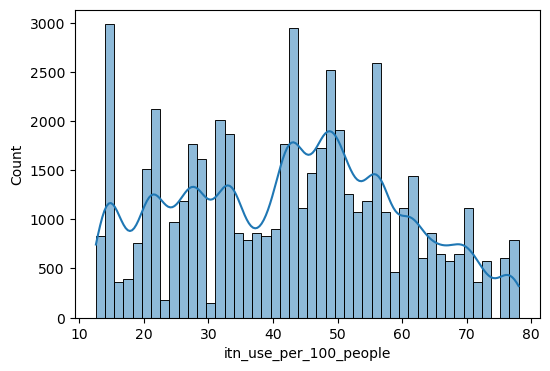

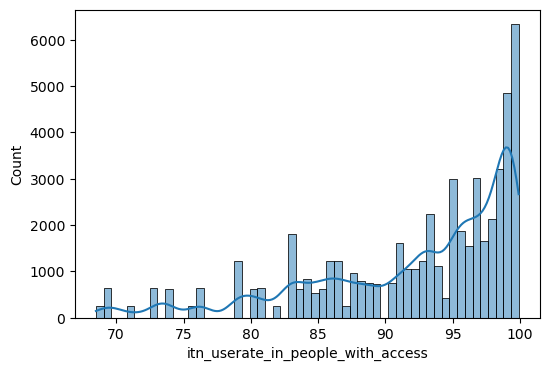

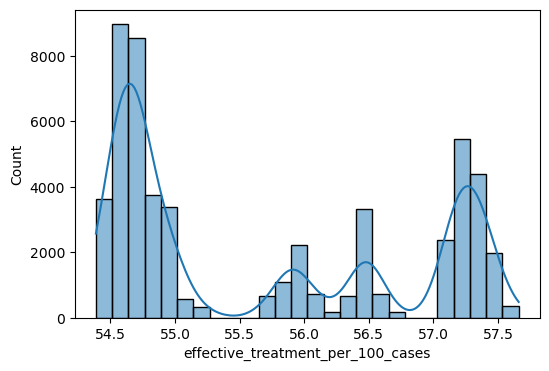

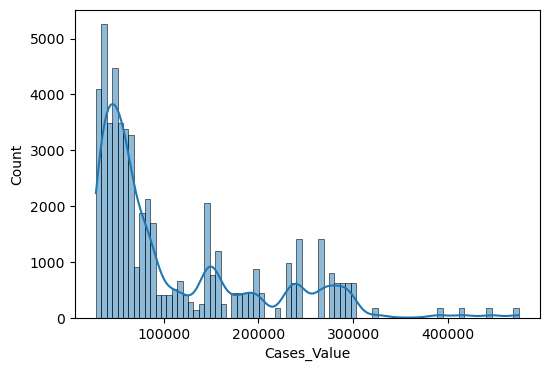

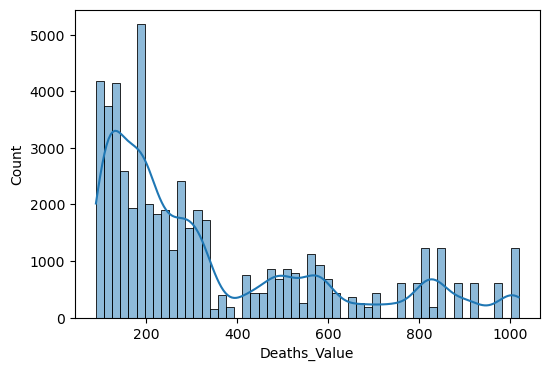

In [12]:
for i in df.columns:
    plt.figure(figsize = (6,4))
    sns.histplot(df[i], kde=True)
    plt.xlabel(i)
    plt.show()

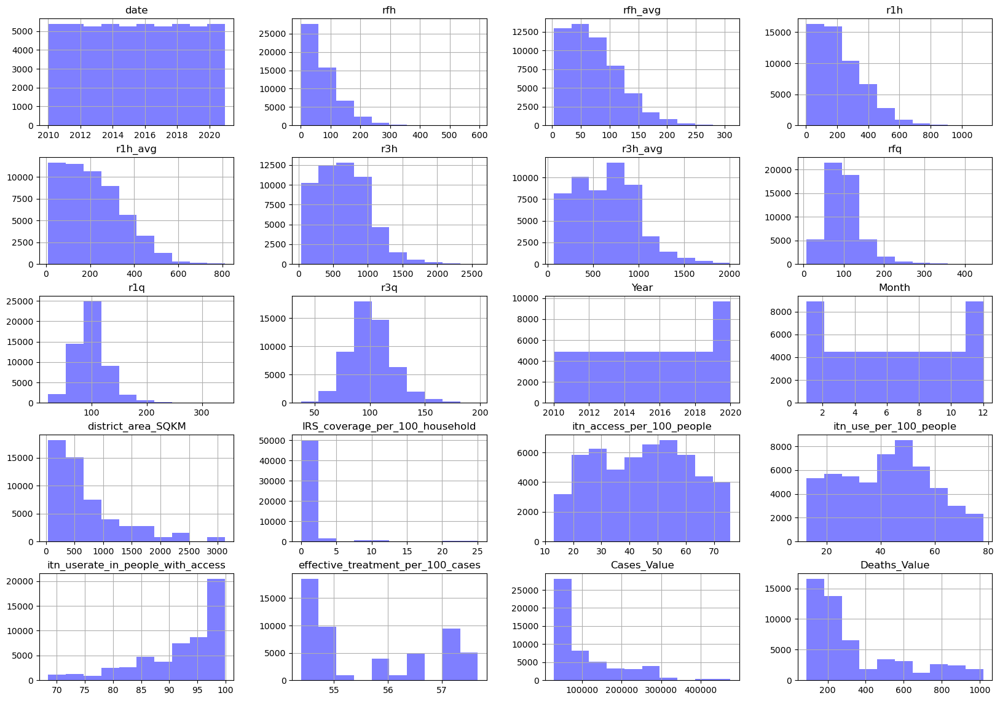

In [13]:
df.hist( color='b', figsize=(20,14), alpha=0.5)
plt.show()

In [14]:
print(df.select_dtypes(include=[np.number]).columns)

Index(['rfh', 'rfh_avg', 'r1h', 'r1h_avg', 'r3h', 'r3h_avg', 'rfq', 'r1q',
       'r3q', 'Year', 'Month', 'district_area_SQKM',
       'IRS_coverage_per_100_household', 'itn_access_per_100_people',
       'itn_use_per_100_people', 'itn_userate_in_people_with_access',
       'effective_treatment_per_100_cases', 'Cases_Value', 'Deaths_Value'],
      dtype='object')


# Correlation Analysis

In [9]:
# Finding correlation:

numeric_df = df.select_dtypes(include=[np.number])
# numeric_df = numeric_df.drop(['Year', 'Month'], axis=1)
df_corr = numeric_df.corr(method='pearson')
df_corr= df_corr.applymap("{:.3f}".format)
df_corr

,rfh,rfh_avg,r1h,r1h_avg,r3h,r3h_avg,rfq,r1q,r3q,Year,Month,district_area_SQKM,IRS_coverage_per_100_household,itn_access_per_100_people,itn_use_per_100_people,itn_userate_in_people_with_access,effective_treatment_per_100_cases,Cases_Value,Deaths_Value
rfh,1.000,0.816,0.828,0.755,0.539,0.511,0.502,0.322,0.163,-0.042,0.249,-0.053,0.000,-0.021,-0.021,-0.022,0.040,-0.055,-0.084
rfh_avg,0.816,1.000,0.848,0.931,0.573,0.624,0.025,0.050,-0.032,0.000,0.283,-0.056,-0.015,-0.017,-0.026,-0.046,0.010,-0.060,-0.106
r1h,0.828,0.848,1.000,0.908,0.739,0.704,0.224,0.393,0.212,-0.050,0.392,-0.063,0.002,-0.026,-0.025,-0.026,0.047,-0.065,-0.099
r1h_avg,0.755,0.931,0.908,1.000,0.720,0.775,0.024,0.053,-0.018,0.000,0.409,-0.059,-0.016,-0.018,-0.027,-0.048,0.010,-0.063,-0.112
r3h,0.539,0.573,0.739,0.720,1.000,0.944,0.125,0.219,0.297,-0.059,0.657,-0.078,0.002,-0.037,-0.036,-0.033,0.064,-0.081,-0.123
r3h_avg,0.511,0.624,0.704,0.775,0.944,1.000,0.025,0.048,0.020,0.000,0.677,-0.071,-0.019,-0.021,-0.033,-0.058,0.012,-0.076,-0.134
rfq,0.502,0.025,0.224,0.024,0.125,0.025,1.000,0.571,0.358,-0.086,0.064,-0.013,0.028,-0.004,0.010,0.038,0.071,-0.009,0.012
r1q,0.322,0.050,0.393,0.053,0.219,0.048,0.571,1.000,0.626,-0.162,0.106,-0.022,0.068,-0.022,0.001,0.050,0.132,-0.018,0.015
r3q,0.163,-0.032,0.212,-0.018,0.297,0.020,0.358,0.626,1.000,-0.221,0.049,-0.035,0.106,-0.087,-0.049,0.072,0.214,-0.027,0.032
Year,-0.042,0.000,-0.050,0.000,-0.059,0.000,-0.086,-0.162,-0.221,1.000,-0.000,-0.000,-0.316,-0.045,-0.083,-0.105,-0.710,0.119,0.057


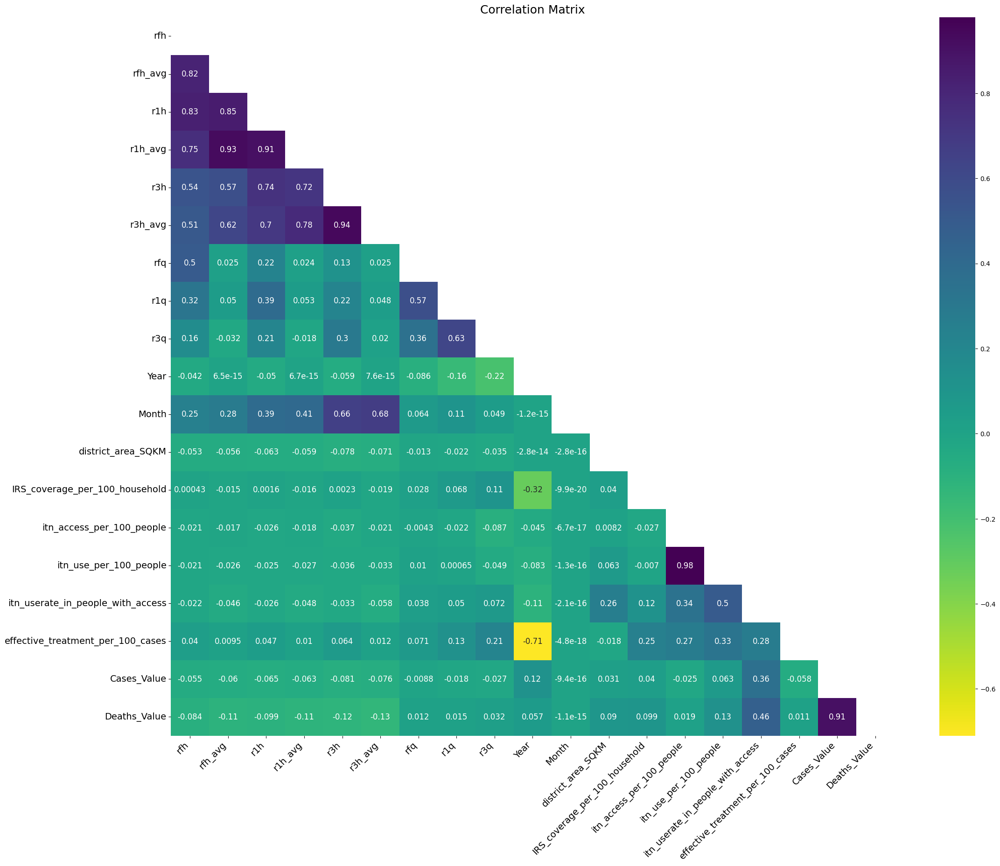

In [10]:
corr_matrix = numeric_df.corr()
plt.figure(figsize=(25, 20))
mask = np.triu(corr_matrix)
sns_plot = sns.heatmap(corr_matrix, annot=True, cmap='viridis_r', annot_kws={"size": 12}, mask=mask)
sns_plot.set_xticklabels(sns_plot.get_xticklabels(), rotation=45, horizontalalignment='right', fontsize=14)
sns_plot.set_yticklabels(sns_plot.get_yticklabels(), rotation=0, verticalalignment='center', fontsize=14)
plt.title('Correlation Matrix', fontsize=18)
plt.show()

In [11]:
df_corr["Deaths_Value"].sort_values(ascending=False)

Deaths_Value                          1.000
Cases_Value                           0.913
itn_userate_in_people_with_access     0.465
itn_use_per_100_people                0.130
IRS_coverage_per_100_household        0.099
district_area_SQKM                    0.090
Year                                  0.057
r3q                                   0.032
itn_access_per_100_people             0.019
r1q                                   0.015
rfq                                   0.012
effective_treatment_per_100_cases     0.011
r3h_avg                              -0.134
r3h                                  -0.123
r1h_avg                              -0.112
rfh_avg                              -0.106
r1h                                  -0.099
rfh                                  -0.084
Month                                -0.000
Name: Deaths_Value, dtype: object

In [12]:
df_corr["Cases_Value"].sort_values(ascending=False)

Cases_Value                           1.000
Deaths_Value                          0.913
itn_userate_in_people_with_access     0.359
Year                                  0.119
itn_use_per_100_people                0.063
IRS_coverage_per_100_household        0.040
district_area_SQKM                    0.031
r3h                                  -0.081
r3h_avg                              -0.076
r1h                                  -0.065
r1h_avg                              -0.063
rfh_avg                              -0.060
effective_treatment_per_100_cases    -0.058
rfh                                  -0.055
r3q                                  -0.027
itn_access_per_100_people            -0.025
r1q                                  -0.018
rfq                                  -0.009
Month                                -0.000
Name: Cases_Value, dtype: object

# Insight into 'Cases_Value' - Histogram Plot

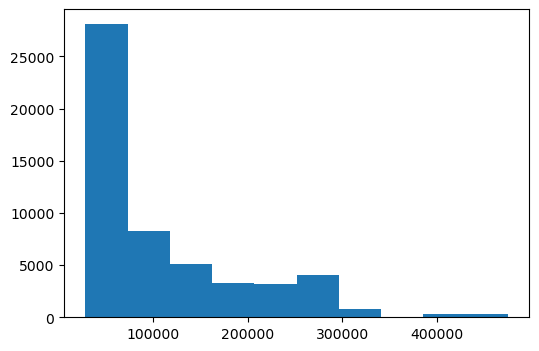

In [19]:
plt.figure(figsize=(6, 4))
plt.hist(df['Cases_Value'])
plt.show()

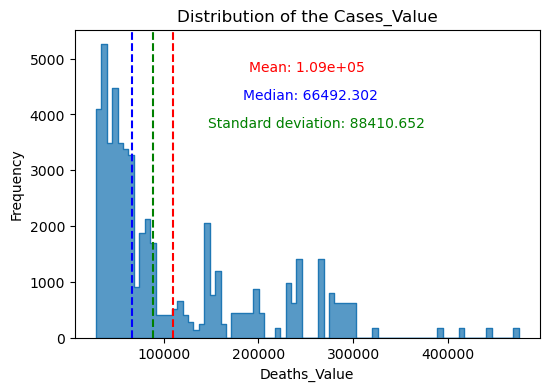

In [20]:
plt.figure(figsize=(6, 4))
sns.histplot(data=df, x='Cases_Value', element='step', common_norm=False)


mean = np.mean(df['Cases_Value'])
median = np.median(df['Cases_Value'])
std_deviation = np.std(df['Cases_Value'])

plt.axvline(mean, color='red', linestyle='--')
plt.axvline(median, color='blue', linestyle='--')
plt.axvline(x=std_deviation, color='green', linestyle='--')

# annotate mean,median & Standard deviation
plt.annotate(f'Mean: {mean:.3}', xy=(mean, plt.gca().get_ylim()[1]), xytext=(55, -30),
             textcoords='offset points', color='red', fontsize=10)
plt.annotate(f'Median: {median:.3f}', xy=(median, plt.gca().get_ylim()[1]), xytext=(80, -50),
             textcoords='offset points', color='blue', fontsize=10)
plt.annotate(f'Standard deviation: {std_deviation:.3f}', xy=(std_deviation, plt.gca().get_ylim()[1]), xytext=(40, -70),
           textcoords='offset points', color='green', fontsize=10)
plt.xlabel('Deaths_Value')
plt.ylabel('Frequency')
plt.title('Distribution of the Cases_Value')
plt.show()

<Axes: xlabel='Cases_Value', ylabel='Count'>

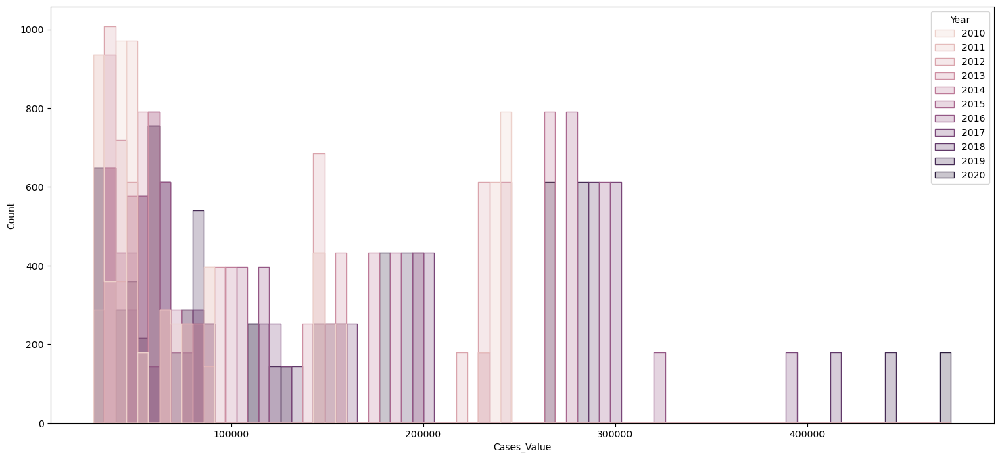

In [21]:
# Histogram Plot for "Cases_Value" and "Year":

plt.figure(figsize=(18, 8))
sns.histplot(data=df, x='Cases_Value', hue='Year', element='step', common_norm=False)

<Axes: xlabel='Cases_Value', ylabel='Count'>

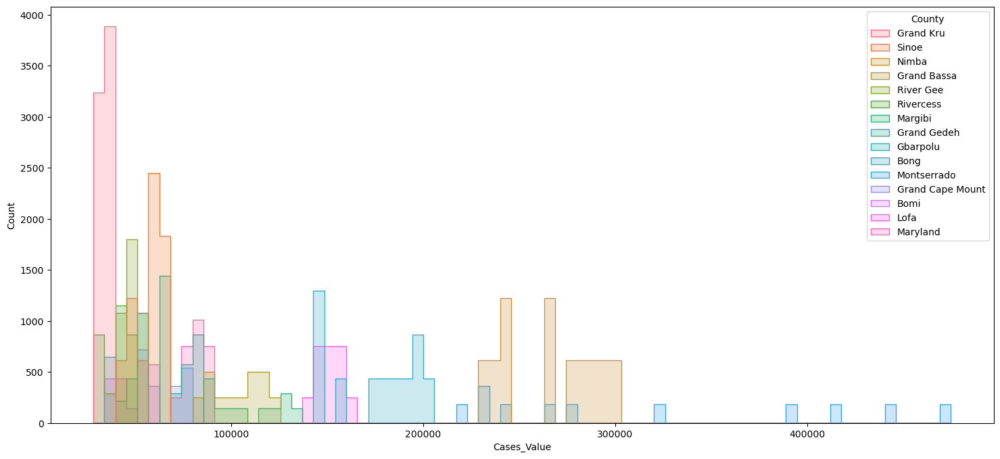

In [22]:
# Histogram Plot for "Cases_Value" and "County":

plt.figure(figsize=(18, 8))
sns.histplot(data=df, x='Cases_Value', hue='County', element='step', common_norm=False)

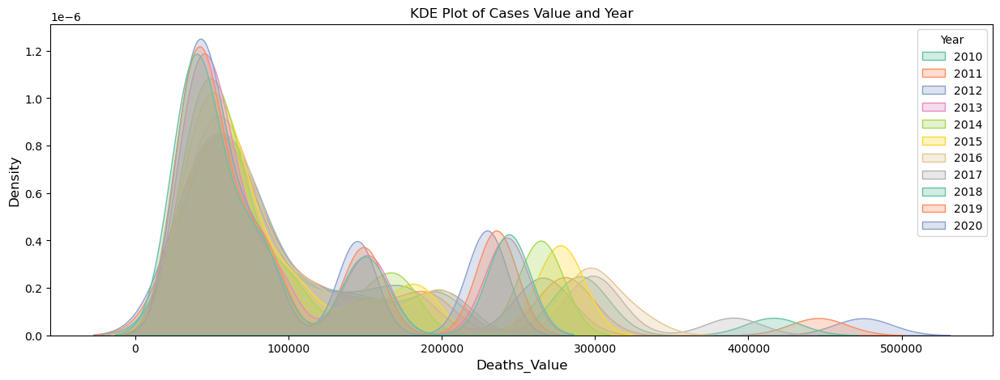

In [23]:
# KDE Plot for "Cases_Value" and "Year":

plt.figure(figsize = (15,5))
sns.kdeplot(data=df, x="Cases_Value", alpha=0.3, shade = True,  hue='Year', palette='Set2')
plt.xlabel('Deaths_Value', fontsize=12)
plt.ylabel('Density', fontsize=12)
plt.title('KDE Plot of Cases Value and Year')
plt.show()

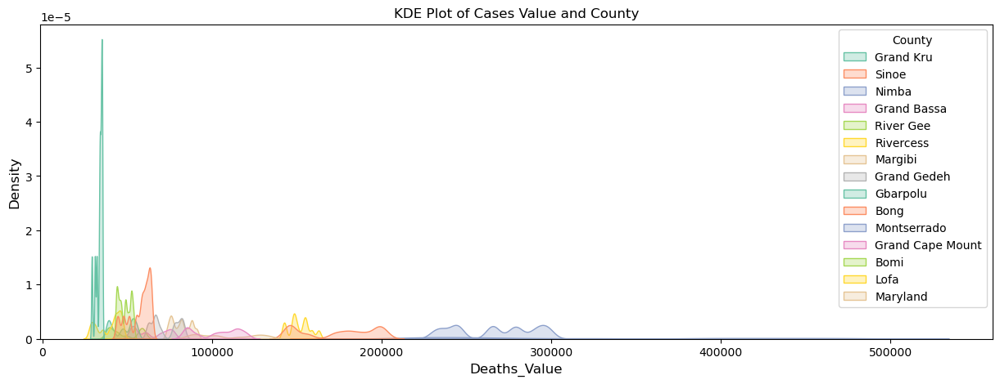

In [24]:
# KDE Plot for "Cases_Value" and "County":

plt.figure(figsize = (15,5))
sns.kdeplot(data=df, x="Cases_Value", alpha=0.3, shade = True,  hue='County', palette='Set2')
plt.xlabel('Deaths_Value', fontsize=12)
plt.ylabel('Density', fontsize=12)
plt.title('KDE Plot of Cases Value and County')
plt.show()

# Insight into 'Deaths_Value' - Histogram Plot

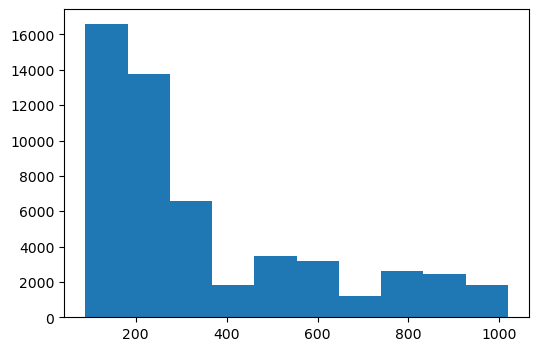

In [25]:
plt.figure(figsize=(6, 4))
plt.hist(df['Deaths_Value'])
plt.show()

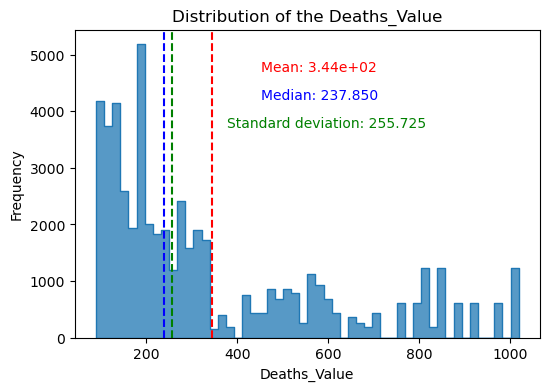

In [26]:
plt.figure(figsize=(6, 4))
sns.histplot(data=df, x='Deaths_Value', element='step', common_norm=False)


mean = np.mean(df['Deaths_Value'])
median = np.median(df['Deaths_Value'])
std_deviation = np.std(df['Deaths_Value'])

plt.axvline(mean, color='red', linestyle='--')
plt.axvline(median, color='blue', linestyle='--')
plt.axvline(x=std_deviation, color='green', linestyle='--')

# annotate mean,median & Standard deviation
plt.annotate(f'Mean: {mean:.3}', xy=(mean, plt.gca().get_ylim()[1]), xytext=(35, -30),
             textcoords='offset points', color='red', fontsize=10)
plt.annotate(f'Median: {median:.3f}', xy=(median, plt.gca().get_ylim()[1]), xytext=(70, -50),
             textcoords='offset points', color='blue', fontsize=10)
plt.annotate(f'Standard deviation: {std_deviation:.3f}', xy=(std_deviation, plt.gca().get_ylim()[1]), xytext=(40, -70),
           textcoords='offset points', color='green', fontsize=10)
plt.xlabel('Deaths_Value')
plt.ylabel('Frequency')
plt.title('Distribution of the Deaths_Value')
plt.show()

<Axes: xlabel='Deaths_Value', ylabel='Count'>

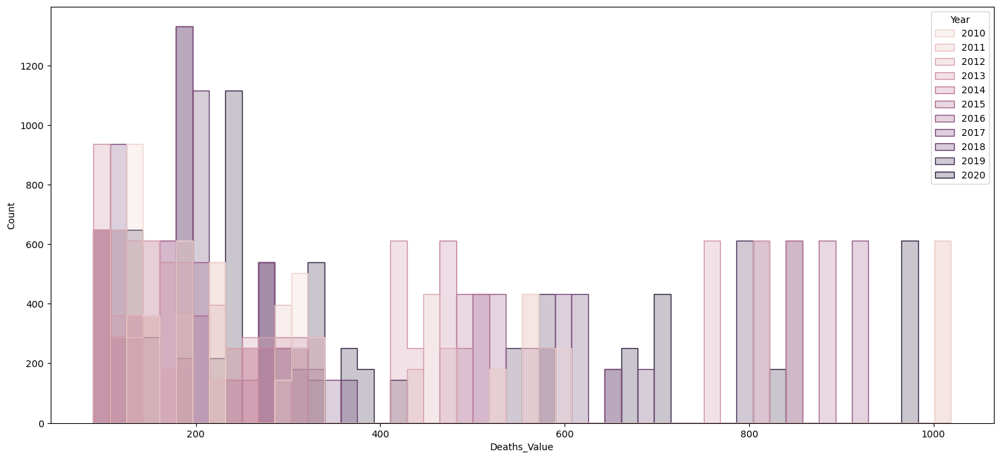

In [27]:
# Histogram Plot for "Deaths_Value" and "Year":

plt.figure(figsize=(18, 8))
sns.histplot(data=df, x='Deaths_Value', hue='Year', element='step', common_norm=False)

<Axes: xlabel='Deaths_Value', ylabel='Count'>

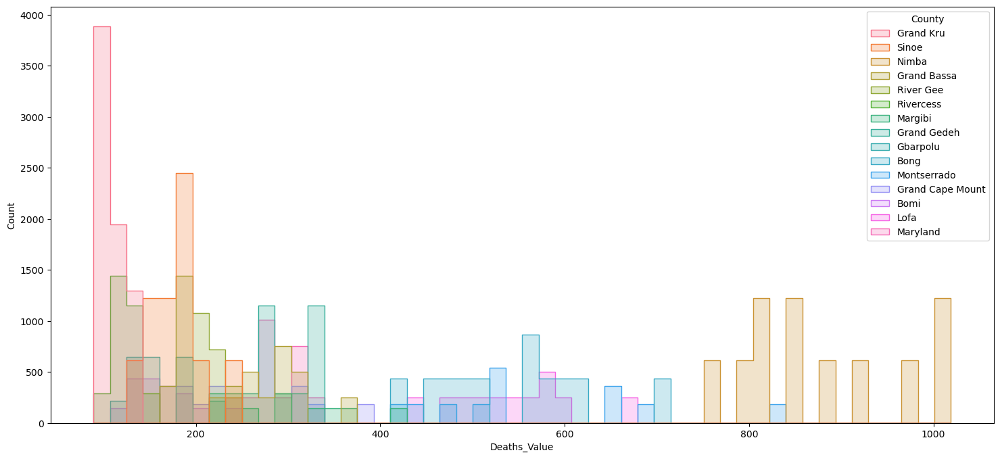

In [28]:
# Histogram Plot for "Deaths_Value" and "County":

plt.figure(figsize=(18, 8))
sns.histplot(data=df, x='Deaths_Value', hue='County', element='step', common_norm=False)

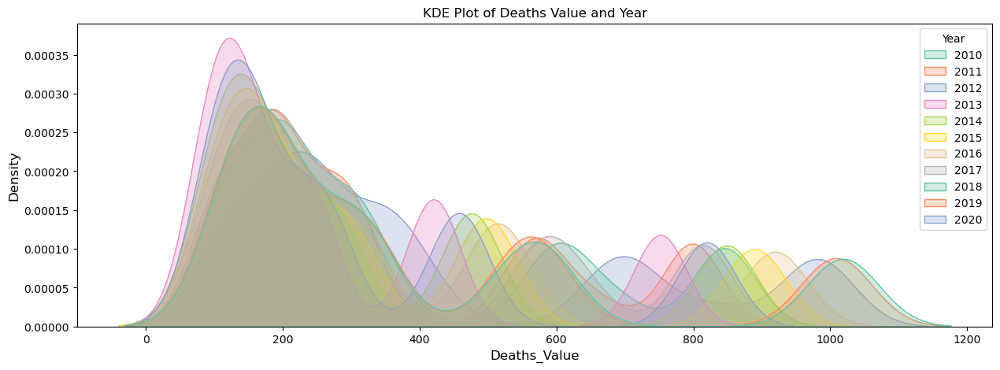

In [29]:
# KDE Plot for "Deaths_Value" and "Year":

plt.figure(figsize = (15,5))
sns.kdeplot(data=df, x="Deaths_Value", alpha=0.3, shade = True,  hue='Year', palette='Set2')
plt.xlabel('Deaths_Value', fontsize=12)
plt.ylabel('Density', fontsize=12)
plt.title('KDE Plot of Deaths Value and Year')
plt.show()

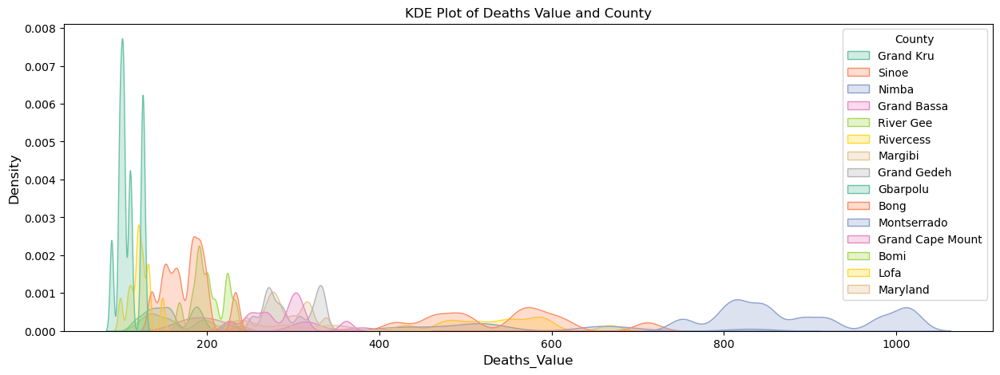

In [30]:
# KDE Plot for "Deaths_Value" and "County":

plt.figure(figsize = (15,5))
sns.kdeplot(data=df, x="Deaths_Value", alpha=0.3, shade = True,  hue='County', palette='Set2')
plt.xlabel('Deaths_Value', fontsize=12)
plt.ylabel('Density', fontsize=12)
plt.title('KDE Plot of Deaths Value and County')
plt.show()

# Scatter Plot of "Deaths_Value" and Numerical Features (hue=year)

In [31]:
print(df.select_dtypes(include=[np.number]).columns)

Index(['rfh', 'rfh_avg', 'r1h', 'r1h_avg', 'r3h', 'r3h_avg', 'rfq', 'r1q',
       'r3q', 'Year', 'Month', 'district_area_SQKM',
       'IRS_coverage_per_100_household', 'itn_access_per_100_people',
       'itn_use_per_100_people', 'itn_userate_in_people_with_access',
       'effective_treatment_per_100_cases', 'Cases_Value', 'Deaths_Value'],
      dtype='object')


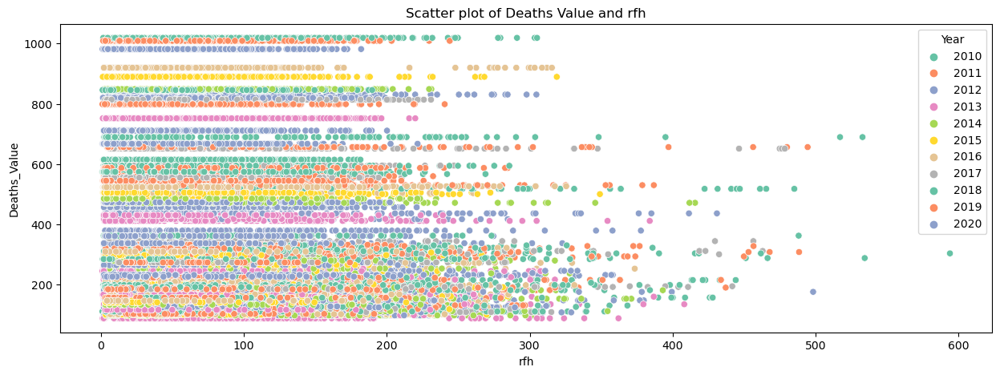

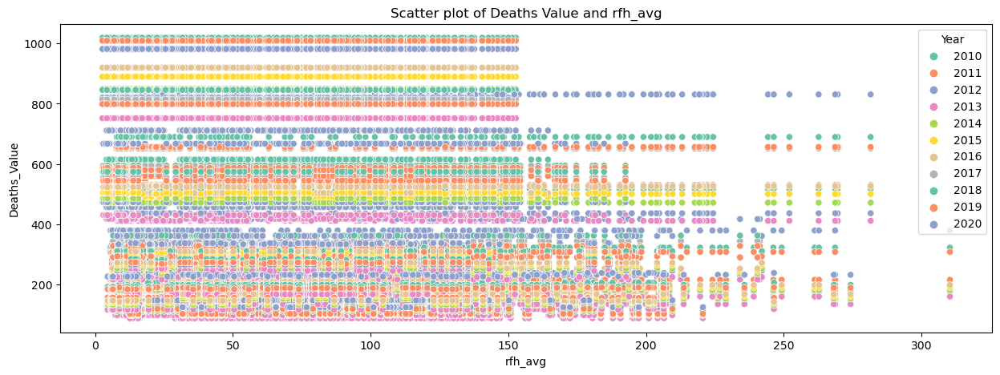

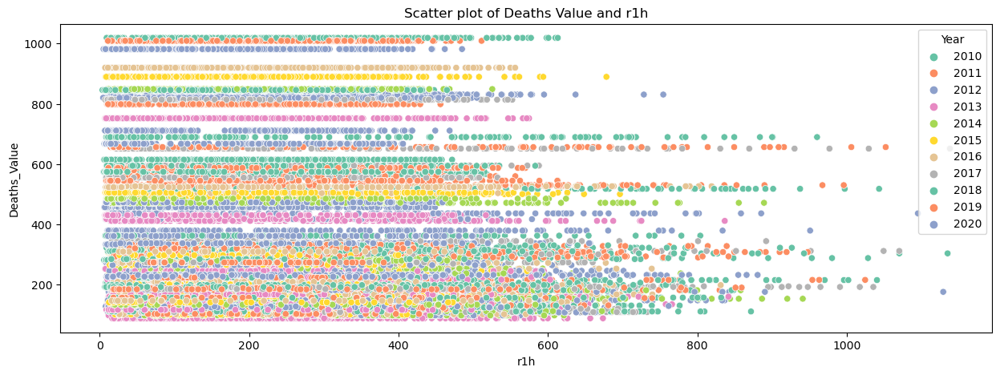

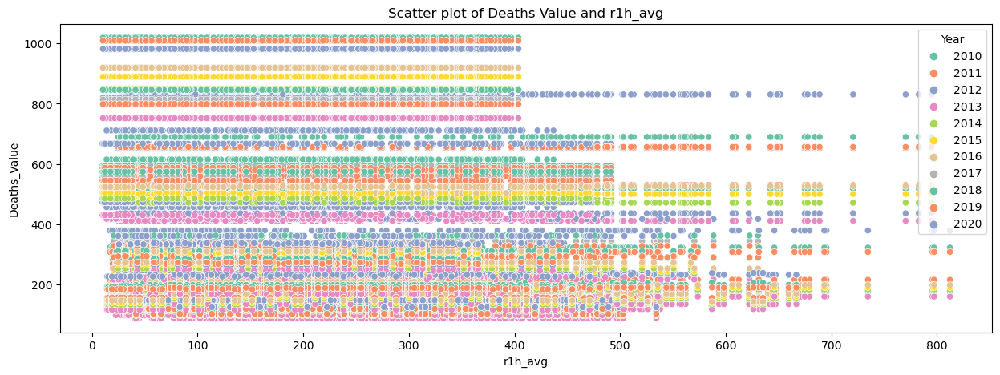

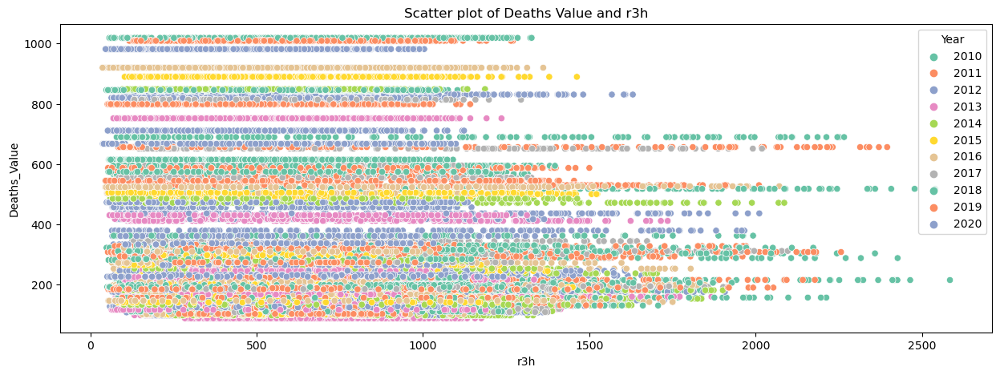

...

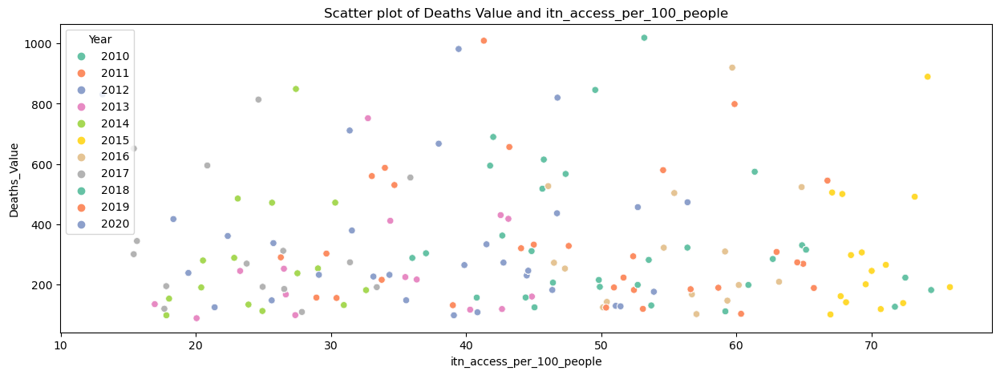

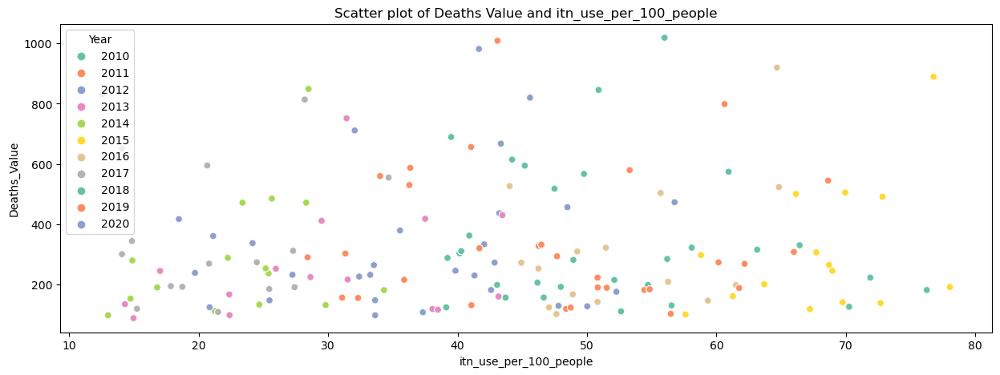

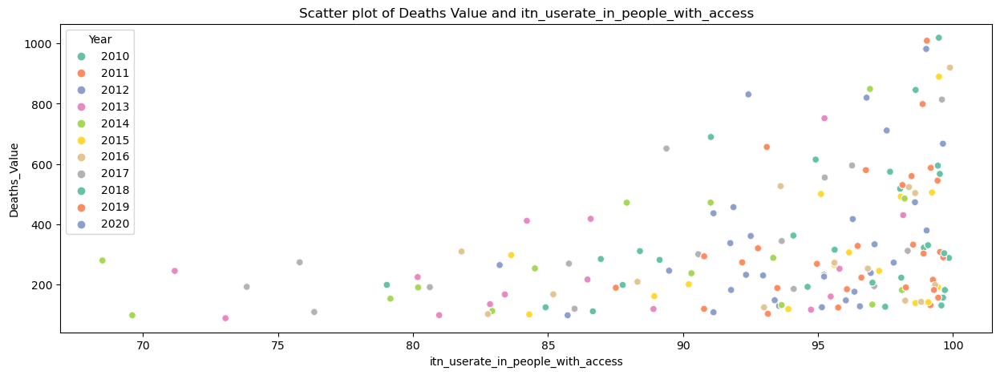

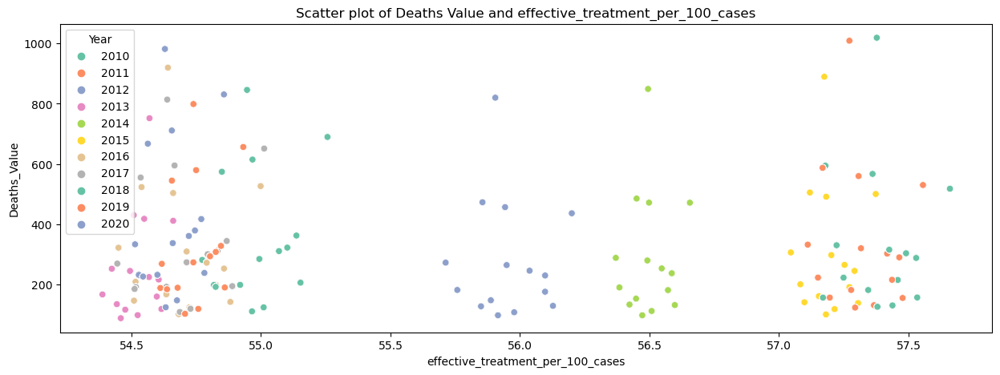

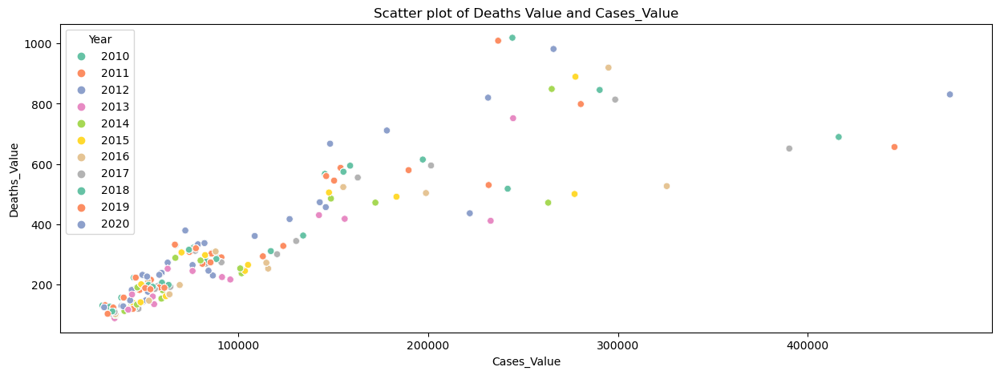

In [32]:
x_variables = ['rfh', 'rfh_avg', 'r1h', 'r1h_avg', 'r3h', 'r3h_avg', 'rfq', 'r1q',
       'r3q', 'district_area_SQKM','IRS_coverage_per_100_household', 'itn_access_per_100_people',
       'itn_use_per_100_people', 'itn_userate_in_people_with_access','effective_treatment_per_100_cases', 'Cases_Value']

# Loop through the x variables and create scatter plots
for x_var in x_variables:
    plt.figure(figsize=(15, 5))
    sns.scatterplot(x=x_var, y='Deaths_Value', hue='Year', palette='Set2', data=df)
    plt.title(f'Scatter plot of Deaths Value and {x_var}')
    plt.show()

# Line Plot of "Deaths_Value" and Top 2 Most Correlated Features (hue=year)

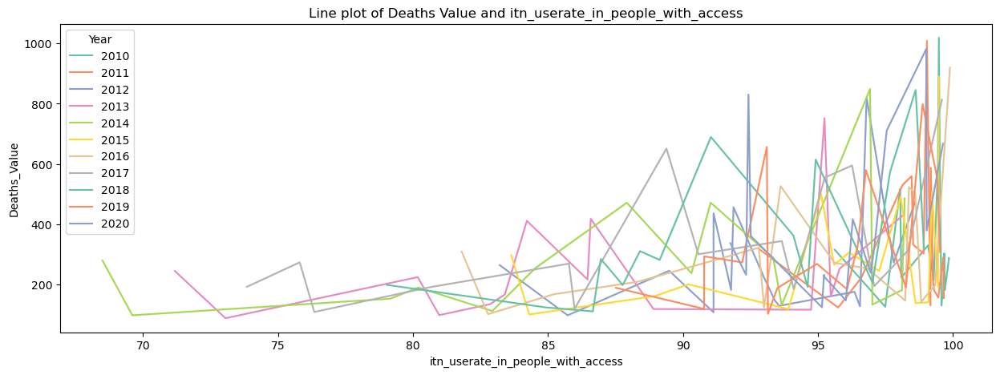

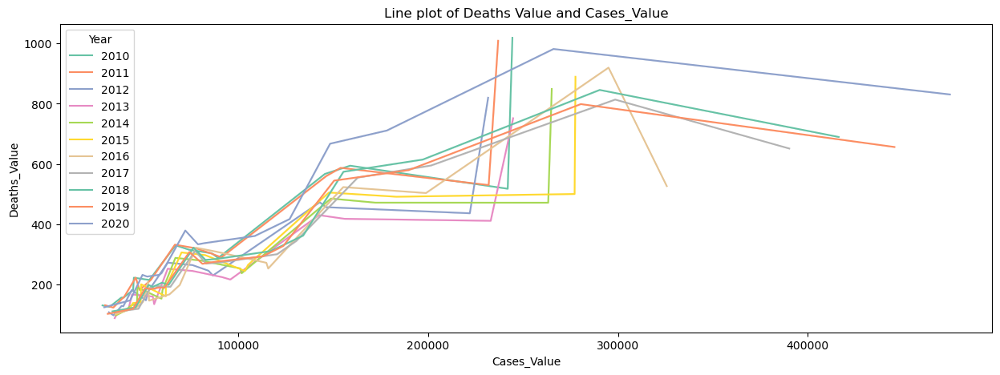

In [33]:
x_variables = ['itn_userate_in_people_with_access','Cases_Value']

for x_var in x_variables:
    plt.figure(figsize=(15, 5))
    sns.lineplot(x=x_var, y="Deaths_Value", hue='Year', palette='Set2', data=df)
    plt.title(f'Line plot of Deaths Value and {x_var}')
    plt.show()

# Joint plot of "Deaths_Value" and Top 2 Most Correlated Features (hue=year)

<Figure size 1500x500 with 0 Axes>

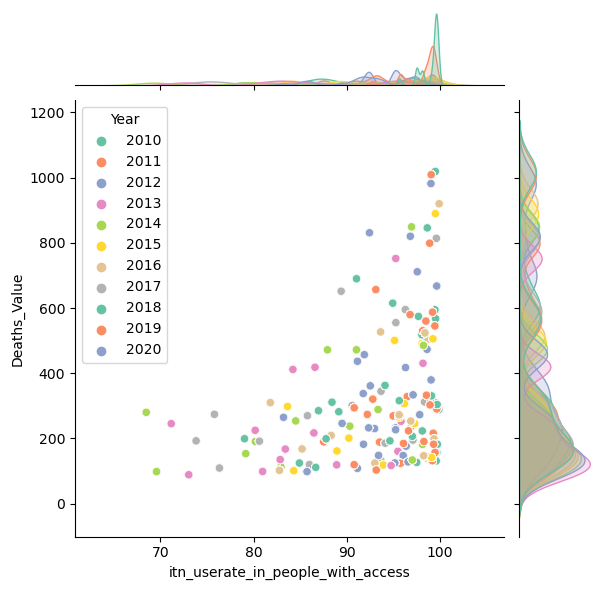

<Figure size 1500x500 with 0 Axes>

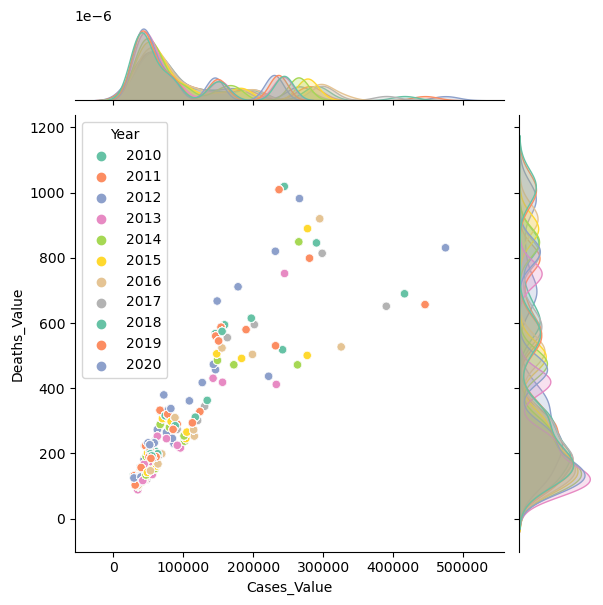

In [34]:
# Joint plot of "itn_userate_in_people_with_access" and "Deaths_Value"

x_variables = ['itn_userate_in_people_with_access','Cases_Value']

for x_var in x_variables:
    plt.figure(figsize=(15, 5))
    sns.jointplot(x=x_var, y="Deaths_Value", hue='Year', palette='Set2', data=df)
    plt.show()

# Box Plot for "Cases_Value" / "Deaths_Value" and "Year"

In [35]:
# Box Plot for "Cases_Value" and "Year":

custom_colors = px.colors.qualitative.Plotly[:len(df['Year'].unique())]

# Create the box plot using plotly with custom colors
fig = px.box(df, x='Year', y='Cases_Value', title='Box Plot for Cases_Value and Year',
             color='Year', color_discrete_sequence=custom_colors)

# Update layout to adjust the figure size
fig.update_layout(width=1000, height=600)

fig.show()

In [36]:
# Box Plot for "Deaths_Value" and "Year":

custom_colors = px.colors.qualitative.Plotly[:len(df['Year'].unique())]

# Create the box plot using plotly with custom colors
fig = px.box(df, x='Year', y='Deaths_Value', title='Box Plot for Deaths_Value and Year',
             color='Year', color_discrete_sequence=custom_colors)

# Update layout to adjust the figure size
fig.update_layout(width=1000, height=600)

fig.show()

# Box Plot for "Cases_Value" / "Deaths_Value" and "County"

In [37]:
# Box Plot for "Cases_Value" and "County":

custom_colors = px.colors.qualitative.Plotly[:len(df['County'].unique())]

# Create the box plot using plotly with custom colors
fig = px.box(df, x='County', y='Cases_Value', title='Box Plot for Cases_Value and County',
             color='County', color_discrete_sequence=custom_colors)

# Update layout to adjust the figure size
fig.update_layout(width=1000, height=600)

fig.show()

In [38]:
# Box Plot for "Deaths_Value" and "County":

custom_colors = px.colors.qualitative.Plotly[:len(df['County'].unique())]

# Create the box plot using plotly with custom colors
fig = px.box(df, x='County', y='Deaths_Value', title='Box Plot for Deaths_Value and County',
             color='County', color_discrete_sequence=custom_colors)

# Update layout to adjust the figure size
fig.update_layout(width=1000, height=600)

fig.show()

# Box Plot for "Cases_Value" / "Deaths_Value" and "District"

In [39]:
# Box Plot for "Deaths_Value" and "District":

custom_colors = px.colors.qualitative.Plotly[:len(df['District'].unique())]

# Create the box plot using plotly with custom colors
fig = px.box(df, x='District', y='Deaths_Value', title='Box Plot for Deaths_Value and District',
             color='District', color_discrete_sequence=custom_colors)

# Update layout to adjust the figure size
fig.update_layout(width=1000, height=600)

fig.show()

In [40]:
# Box Plot for "Cases_Value" and "District":

custom_colors = px.colors.qualitative.Plotly[:len(df['District'].unique())]

# Create the box plot using plotly with custom colors
fig = px.box(df, x='District', y='Cases_Value', title='Box Plot for Cases_Value and District',
             color='District', color_discrete_sequence=custom_colors)

# Update layout to adjust the figure size
fig.update_layout(width=1000, height=600)

fig.show()

# Average "Cases_Value" / "Deaths_Value" for "Year"

In [41]:
# Group data by "Year" and calculate the Average Cases_Value:
average_Cases_Value = df.groupby("Year")["Cases_Value"].mean().reset_index()

# Sort the data by "Deaths_Value" in descending order
average_Cases_Value = average_Cases_Value.sort_values(by="Cases_Value", ascending=False)

# Create the bar chart using plotly
fig = px.bar(average_Cases_Value, x="Year", y="Cases_Value", color="Year",
             labels={"Year": "Year", "Cases_Value": "Average Cases_Value"},
             title="Average Cases Value for each Year")

# Set font size for x and y axis labels
fig.update_xaxes(title_font_size=12, tickfont_size=12)
fig.update_yaxes(title_font_size=12, tickfont_size=12)

# Rotate x-axis labels
#fig.update_xaxes(tickangle=90)

fig.show()



In [42]:
# Group data by "Year" and calculate the Average Deaths_Value:
average_Deaths_Value = df.groupby("Year")["Deaths_Value"].mean().reset_index()

# Sort the data by "Deaths_Value" in descending order
average_Deaths_Value = average_Deaths_Value.sort_values(by="Deaths_Value", ascending=False)

# Create the bar chart using plotly
fig = px.bar(average_Deaths_Value, x="Year", y="Deaths_Value", color="Year",
             labels={"Year": "Year", "Deaths_Value": "Average Deaths_Value"},
             title="Average Deaths Value for each Year")

# Set font size for x and y axis labels
fig.update_xaxes(title_font_size=12, tickfont_size=12)
fig.update_yaxes(title_font_size=12, tickfont_size=12)

# Rotate x-axis labels
#fig.update_xaxes(tickangle=90)

fig.show()

# Average "Cases_Value" / "Deaths_Value" for "County"

In [43]:
# Group data by "County" and calculate the Average Cases_Value:
average_Cases_Value = df.groupby("County")["Cases_Value"].mean().reset_index()

# Sort the data by "Deaths_Value" in descending order
average_Cases_Value = average_Cases_Value.sort_values(by="Cases_Value", ascending=False)

# Create the bar chart using plotly
fig = px.bar(average_Cases_Value, x="County", y="Cases_Value", color="County",
             labels={"County": "County", "Cases_Value": "Average Cases_Value"},
             title="Average Cases Value for each County")

# Set font size for x and y axis labels
fig.update_xaxes(title_font_size=12, tickfont_size=12)
fig.update_yaxes(title_font_size=12, tickfont_size=12)

# Rotate x-axis labels
#fig.update_xaxes(tickangle=90)

fig.show()


In [44]:
# Group data by "County" and calculate the Average Deaths_Value:
average_Deaths_Value = df.groupby("County")["Deaths_Value"].mean().reset_index()

# Sort the data by "Deaths_Value" in descending order
average_Deaths_Value = average_Deaths_Value.sort_values(by="Deaths_Value", ascending=False)

# Create the bar chart using plotly
fig = px.bar(average_Deaths_Value, x="County", y="Deaths_Value", color="County",
             labels={"County": "County", "Deaths_Value": "Average Deaths_Value"},
             title="Average Deaths Value for each County")

# Set font size for x and y axis labels
fig.update_xaxes(title_font_size=12, tickfont_size=12)
fig.update_yaxes(title_font_size=12, tickfont_size=12)

# Rotate x-axis labels
#fig.update_xaxes(tickangle=90)

fig.show()

# Average "Cases_Value" / "Deaths_Value" for "District"

In [45]:
# Group data by "District" and calculate the Average Cases_Value:
average_Cases_Value = df.groupby("District")["Cases_Value"].mean().reset_index()

# Sort the data by "Deaths_Value" in descending order
average_Cases_Value = average_Cases_Value.sort_values(by="Cases_Value", ascending=False)

# Create the bar chart using plotly
fig = px.bar(average_Cases_Value, x="District", y="Cases_Value", color="District",
             labels={"District": "District", "Cases_Value": "Average Cases_Value"},
             title="Average Cases Value for each District")

# Set font size for x and y axis labels
fig.update_xaxes(title_font_size=12, tickfont_size=12)
fig.update_yaxes(title_font_size=12, tickfont_size=12)

# Rotate x-axis labels
#fig.update_xaxes(tickangle=90)

fig.show()



In [46]:
# Group data by "District" and calculate the Average Deaths_Value:
average_Deaths_Value = df.groupby("District")["Deaths_Value"].mean().reset_index()

# Sort the data by "Deaths_Value" in descending order
average_Deaths_Value = average_Deaths_Value.sort_values(by="Deaths_Value", ascending=False)

# Create the bar chart using plotly
fig = px.bar(average_Deaths_Value, x="District", y="Deaths_Value", color="District",
             labels={"District": "District", "Deaths_Value": "Average Deaths_Value"},
             title="Average Deaths Value for each District")

# Set font size for x and y axis labels
fig.update_xaxes(title_font_size=12, tickfont_size=12)
fig.update_yaxes(title_font_size=12, tickfont_size=12)

# Rotate x-axis labels
#fig.update_xaxes(tickangle=90)

fig.show()

# Time Series Analysis - "Deaths_Value"

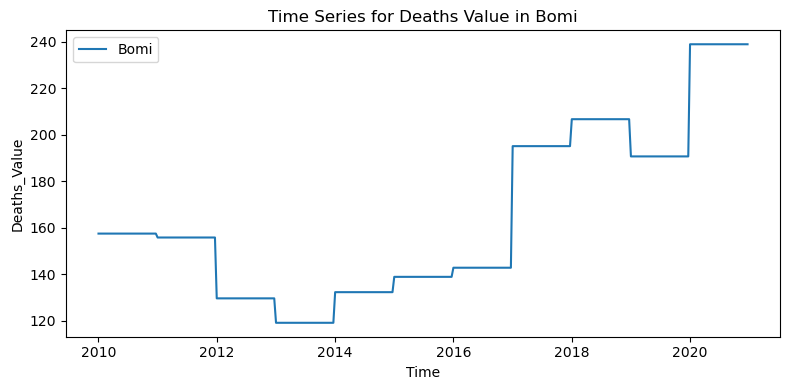

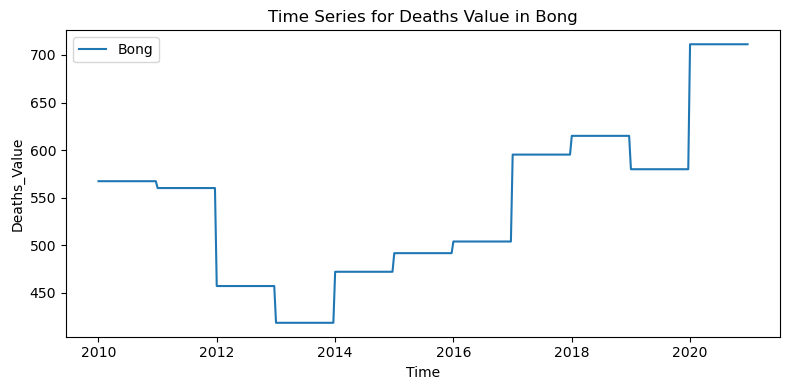

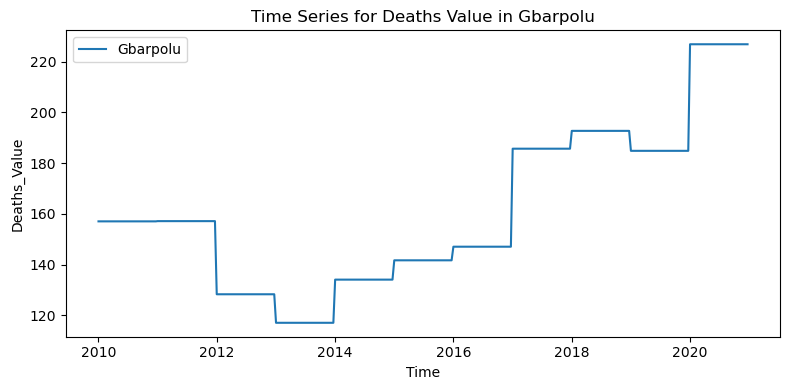

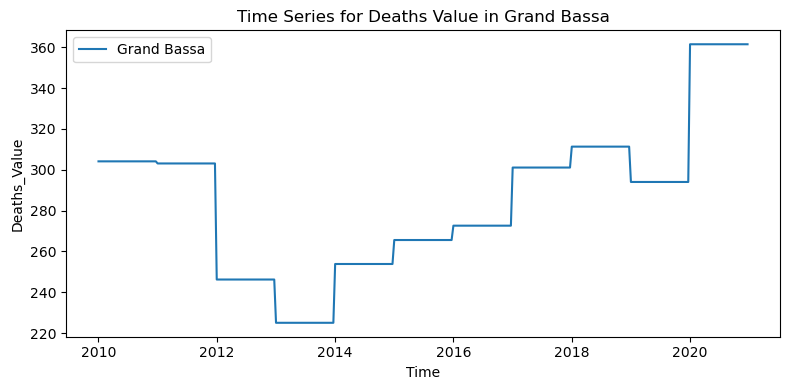

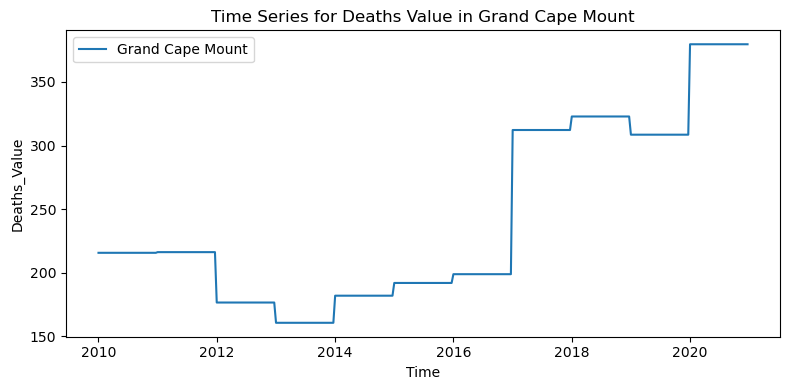

...

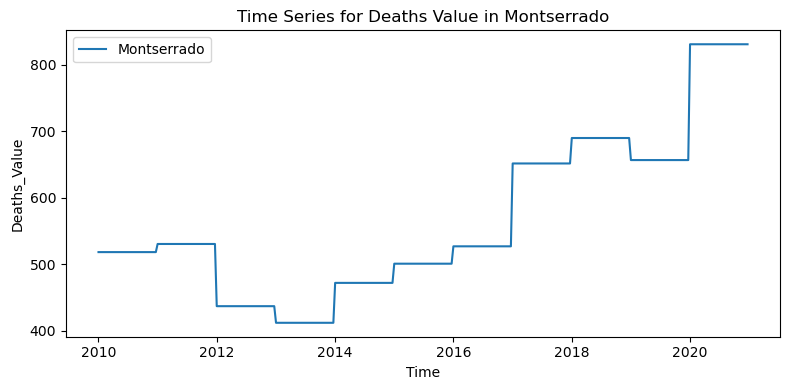

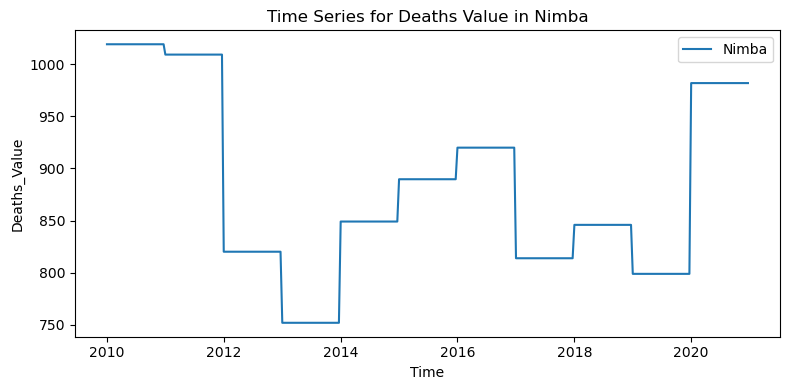

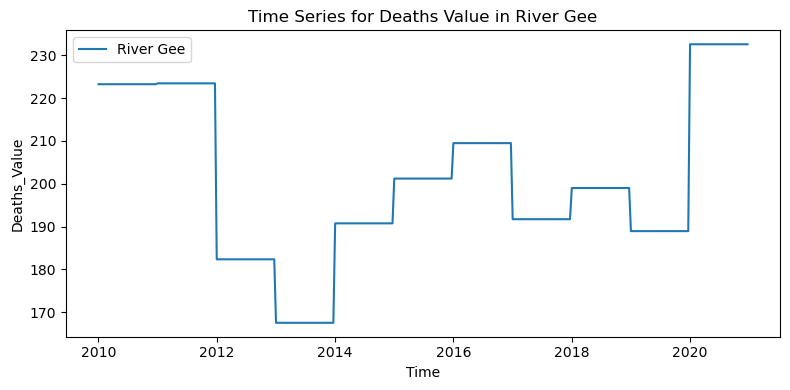

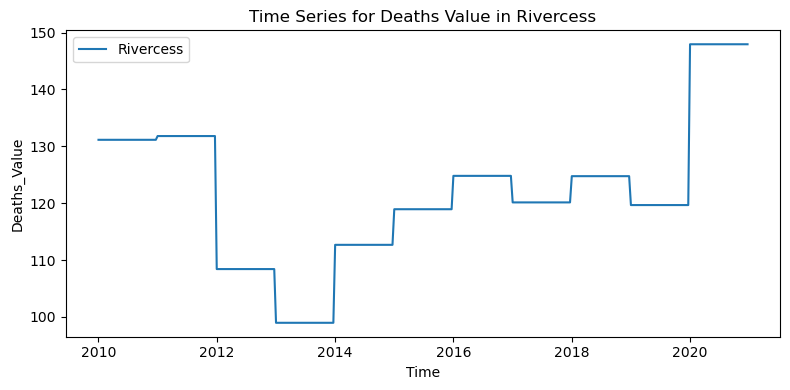

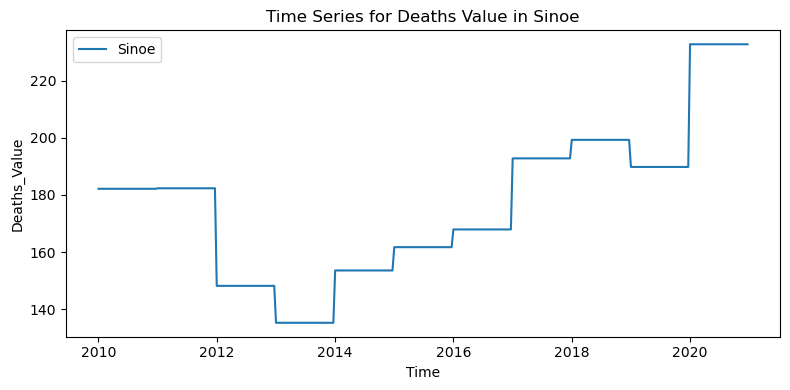

In [47]:
# Sort the DataFrame by the "date" column
df_sorted = df.sort_values('date')

# Plot the time series for each County
for County, group_data in df_sorted.groupby('County'):
    plt.figure(figsize=(8, 4))
    plt.plot(group_data['date'].values, group_data['Deaths_Value'].values, label=County)
    plt.title(f'Time Series for Deaths Value in {County}')
    plt.xlabel('Time')
    plt.ylabel('Deaths_Value')
    plt.legend()
    #plt.grid(True)
    plt.tight_layout()
    plt.show()


# Time Series Analysis - "Cases_Value"

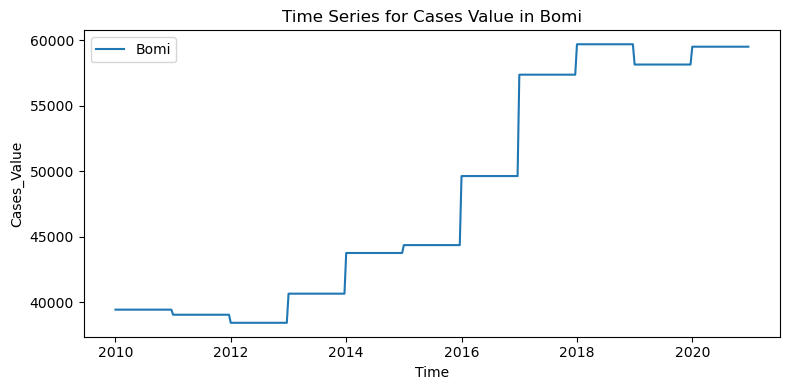

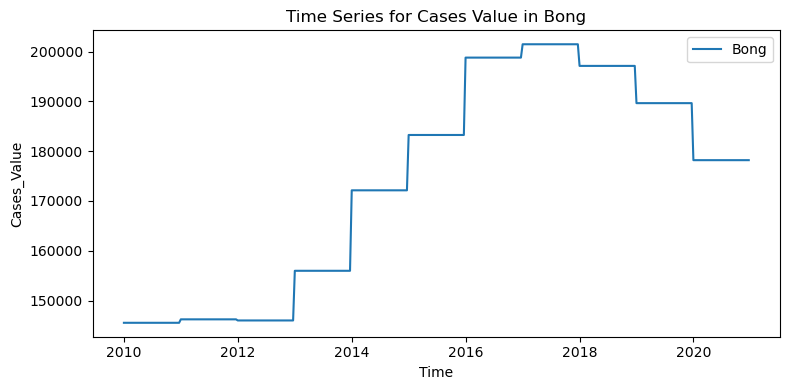

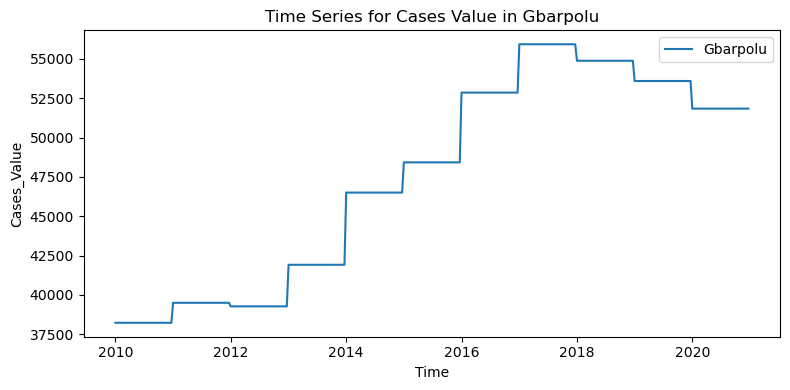

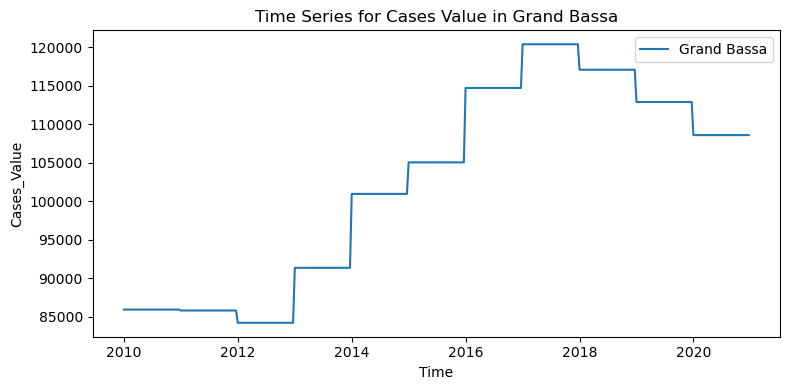

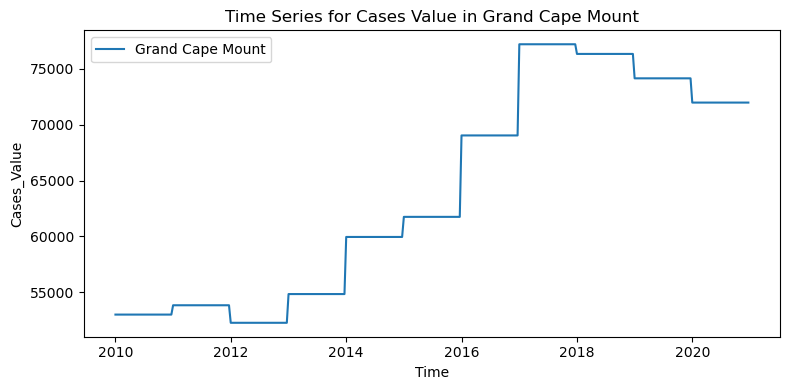

...

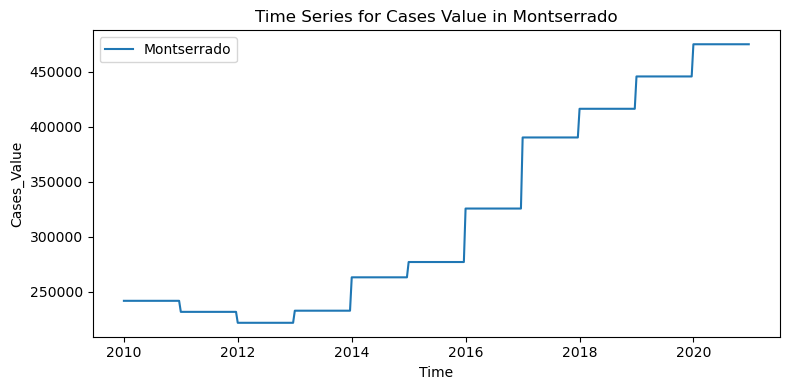

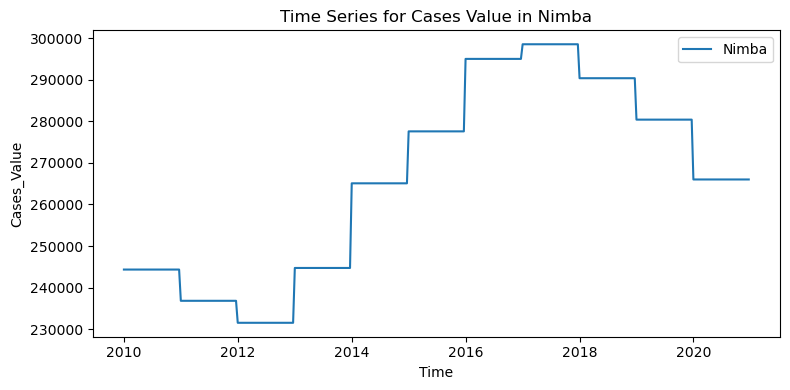

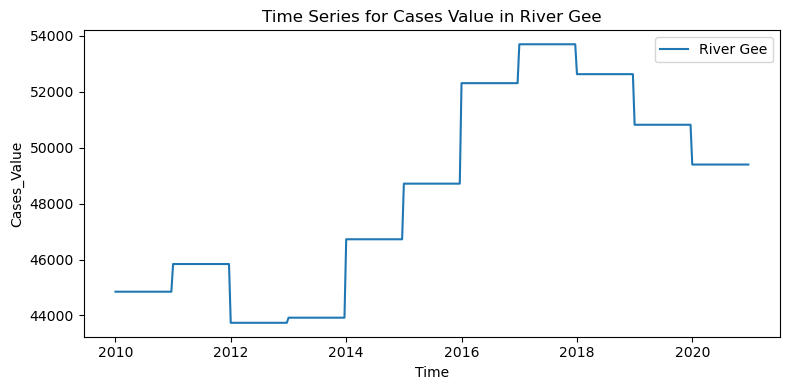

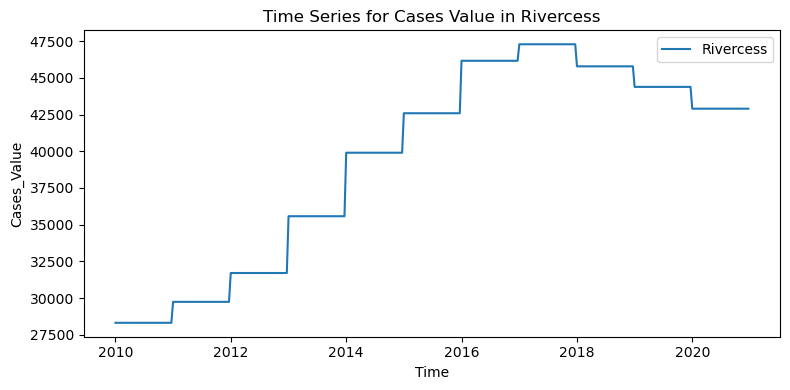

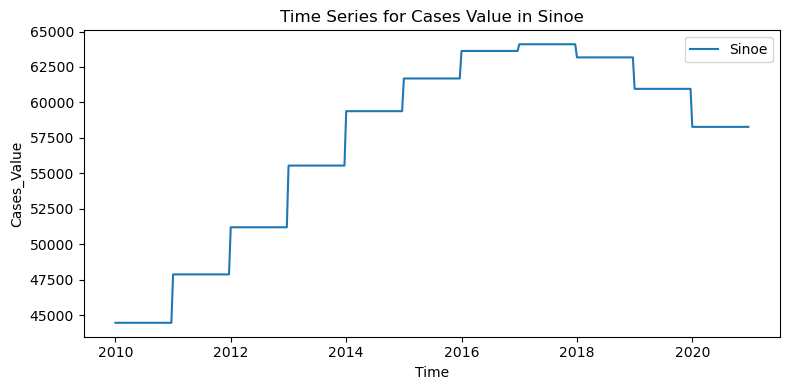

In [48]:
# Sort the DataFrame by the "date" column
df_sorted = df.sort_values('date')

# Plot the time series for each County
for County, group_data in df_sorted.groupby('County'):
    plt.figure(figsize=(8, 4))
    plt.plot(group_data['date'].values, group_data['Cases_Value'].values, label=County)
    plt.title(f'Time Series for Cases Value in {County}')
    plt.xlabel('Time')
    plt.ylabel('Cases_Value')
    plt.legend()
    #plt.grid(True)
    plt.tight_layout()
    plt.show()


# Time Series Analysis : "Cases_Value" vs "Deaths_Value"

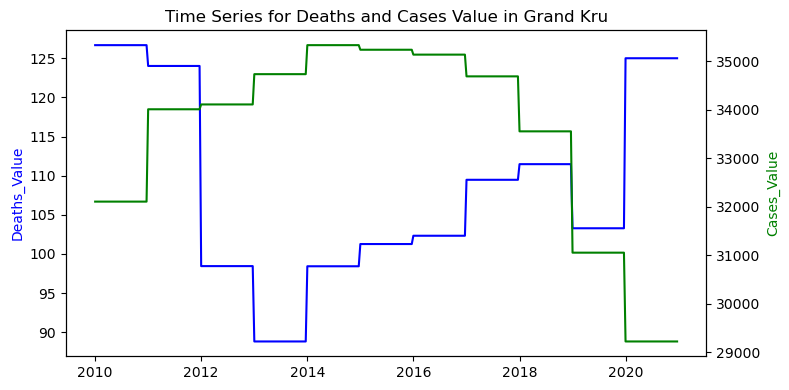

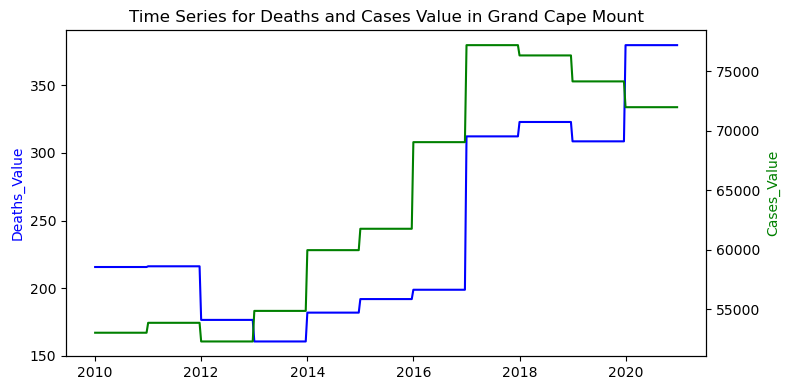

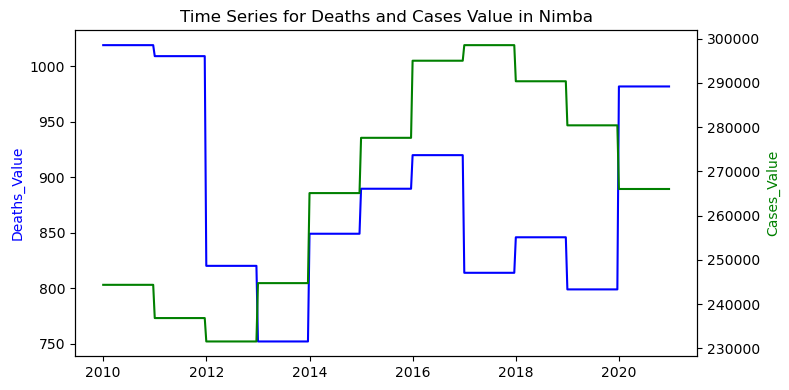

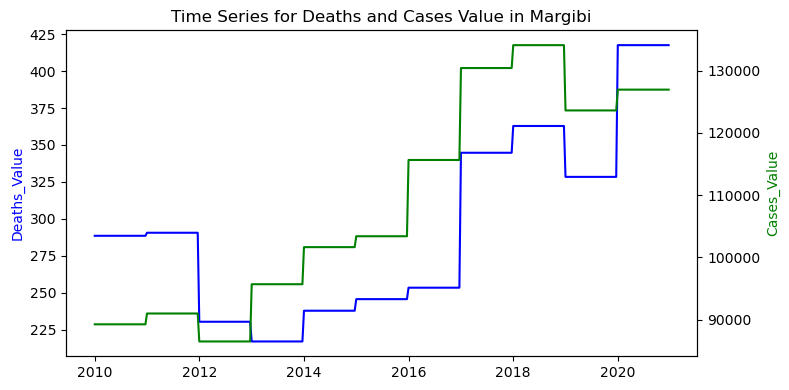

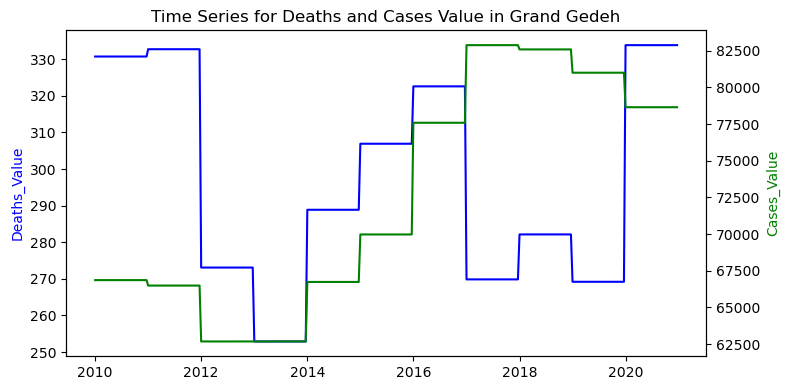

...

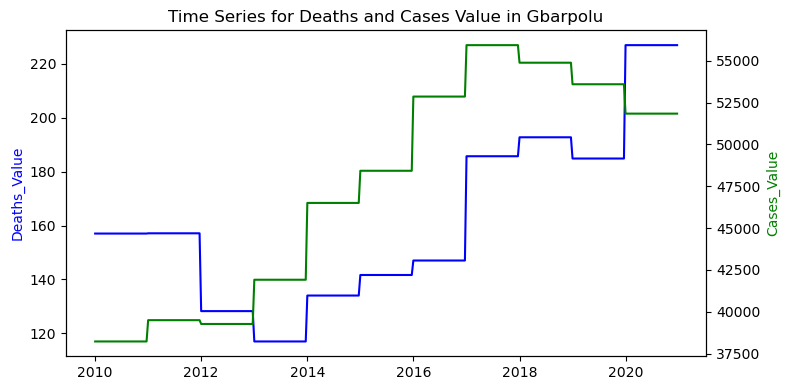

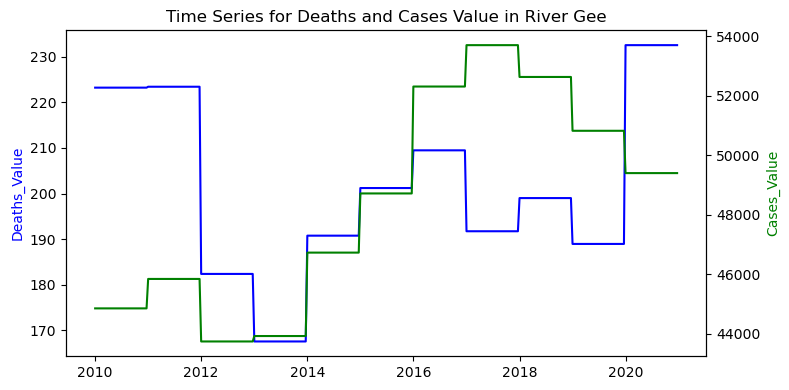

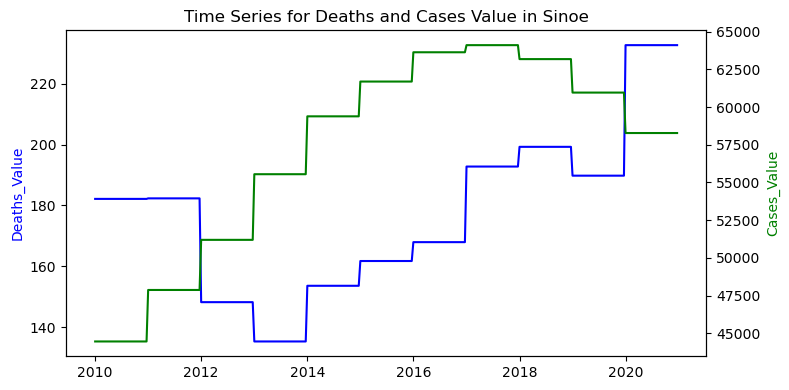

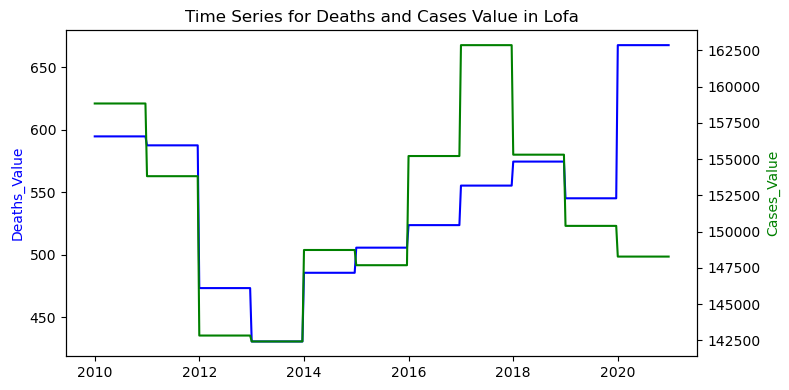

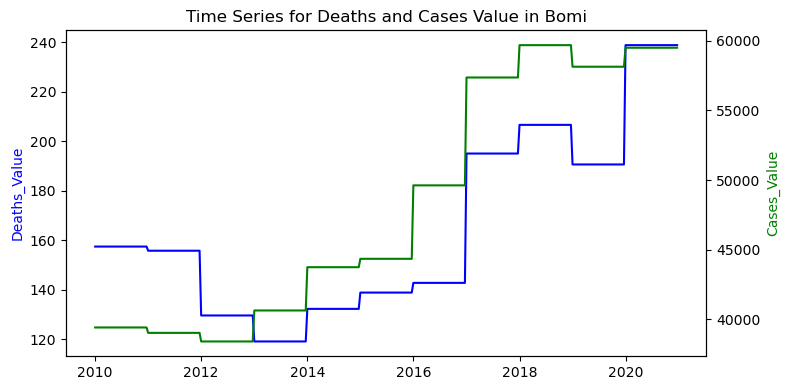

In [49]:
# Sort the DataFrame by the "date" column
df_sorted = df.sort_values('date')

# Get unique counties
counties = df_sorted['County'].unique()

# Plot both Deaths_Value and Cases_Value for each County
for county in counties:
    # Filter data for the current county
    county_data = df_sorted[df_sorted['County'] == county]

    # Create a figure
    fig, ax1 = plt.subplots(figsize=(8, 4))
    
    # Plot Deaths_Value on the left y-axis in blue
    ax1.plot(county_data['date'].values, county_data['Deaths_Value'].values, label='Deaths_Value', color='blue')
    ax1.set_ylabel('Deaths_Value', color='blue')
    
    # Create a second y-axis for Cases_Value on the right side
    ax2 = ax1.twinx()
    ax2.plot(county_data['date'].values, county_data['Cases_Value'].values, label='Cases_Value', color='green')
    ax2.set_ylabel('Cases_Value', color='green')

    plt.title(f'Time Series for Deaths and Cases Value in {county}')
    plt.xlabel('Time')
    plt.tight_layout()
    plt.show()


In [50]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 53460 entries, 0 to 53459
Data columns (total 22 columns):
 #   Column                             Non-Null Count  Dtype         
---  ------                             --------------  -----         
 0   date                               53460 non-null  datetime64[ns]
 1   rfh                                53460 non-null  float64       
 2   rfh_avg                            53460 non-null  float64       
 3   r1h                                53460 non-null  float64       
 4   r1h_avg                            53460 non-null  float64       
 5   r3h                                53460 non-null  float64       
 6   r3h_avg                            53460 non-null  float64       
 7   rfq                                53460 non-null  float64       
 8   r1q                                53460 non-null  float64       
 9   r3q                                53460 non-null  float64       
 10  Year                              

# Modeling - Target: Deaths_Value

In [51]:
print(df.select_dtypes(include=[np.number]).columns)

Index(['rfh', 'rfh_avg', 'r1h', 'r1h_avg', 'r3h', 'r3h_avg', 'rfq', 'r1q',
       'r3q', 'Year', 'Month', 'district_area_SQKM',
       'IRS_coverage_per_100_household', 'itn_access_per_100_people',
       'itn_use_per_100_people', 'itn_userate_in_people_with_access',
       'effective_treatment_per_100_cases', 'Cases_Value', 'Deaths_Value'],
      dtype='object')


In [52]:
print(df.select_dtypes(include=["object"]).columns)

Index(['District', 'County'], dtype='object')


In [53]:
# exclude_columns = ["Deaths_Value", "Year", "Month"]

# Select desired num_var:

num_var = ['rfh', 'rfh_avg', 'r1h', 'r1h_avg', 'r3h', 'r3h_avg', 'rfq', 'r1q',
       'r3q', 'district_area_SQKM',
       'IRS_coverage_per_100_household', 'itn_access_per_100_people',
       'itn_use_per_100_people', 'itn_userate_in_people_with_access',
       'effective_treatment_per_100_cases', 'Cases_Value']

cat_var = ['District', 'County']
y = df['Deaths_Value']
X = df[cat_var + num_var]
y = pd.DataFrame(y, columns=['Deaths_Value'])

In [54]:
print(type(X))
print(type(y))

<class 'pandas.core.frame.DataFrame'>
<class 'pandas.core.frame.DataFrame'>


In [55]:
X.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 53460 entries, 0 to 53459
Data columns (total 18 columns):
 #   Column                             Non-Null Count  Dtype  
---  ------                             --------------  -----  
 0   District                           53460 non-null  object 
 1   County                             53460 non-null  object 
 2   rfh                                53460 non-null  float64
 3   rfh_avg                            53460 non-null  float64
 4   r1h                                53460 non-null  float64
 5   r1h_avg                            53460 non-null  float64
 6   r3h                                53460 non-null  float64
 7   r3h_avg                            53460 non-null  float64
 8   rfq                                53460 non-null  float64
 9   r1q                                53460 non-null  float64
 10  r3q                                53460 non-null  float64
 11  district_area_SQKM                 53460 non-null  flo

In [56]:
# Train-test split:

X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.3, random_state=42 , shuffle=True)

print(f"X_train.shape: {X_train.shape}")
print(f"X_test.shape: {X_test.shape}")
print(f"y_train.shape: {y_train.shape}")
print(f"y_test.shape: {y_test.shape}")

X_train.shape: (37422, 18)
X_test.shape: (16038, 18)
y_train.shape: (37422, 1)
y_test.shape: (16038, 1)


In [57]:
# Preprocessing with pipelines

from sklearn.pipeline import Pipeline  
from sklearn.compose import ColumnTransformer 
from sklearn.preprocessing import MinMaxScaler, OneHotEncoder 


pipeline_categorical = Pipeline([('onehot', OneHotEncoder(handle_unknown="ignore")),])

pipeline_numerical = Pipeline([('scaler', MinMaxScaler(feature_range=(0,1))),])

pipeline_full = ColumnTransformer([("categorical", pipeline_categorical, cat_var),
                                   ("numerical", pipeline_numerical, num_var)])

In [58]:
# Apply the pipeline

pipeline_full.fit(X_train)

X_train_transformed = pipeline_full.transform(X_train)
X_test_transformed = pipeline_full.transform(X_test)

print(f"X_train_transformed.shape: {X_train_transformed.shape}")
print(f"X_test_transformed.shape: {X_test_transformed.shape}")
print()
print('X_train_transformed:', type(X_train_transformed))
print('X_test_transformed:', type(X_test_transformed))

X_train_transformed.shape: (37422, 166)
X_test_transformed.shape: (16038, 166)

X_train_transformed: <class 'scipy.sparse._csr.csr_matrix'>
X_test_transformed: <class 'scipy.sparse._csr.csr_matrix'>


In [59]:
models = {
    'LinearRegression': LinearRegression(),
    'LassoRegressor': Lasso(max_iter=10000, random_state=42),  
    'RidgeRegressor': Ridge(max_iter=10000, random_state=42),  
    "ElasticNet": ElasticNet(alpha=0.02, random_state=42),  
    "KNN": KNeighborsRegressor(),
    'DTR': DecisionTreeRegressor(random_state=42), 
    'SVR': SVR(),
    'RFR': RandomForestRegressor(random_state=42),  
    "ExtraTrees": ExtraTreesRegressor(n_estimators=5, random_state=42), 
    'ADABoost': AdaBoostRegressor(random_state=42), 
    'XGBoost': xgb.XGBRegressor(random_state=42)  
} 

In [60]:
# Train multiple models

model_list=[]
r2_list=[]
mae_list=[]
mse_list=[]
rmse_list=[]

for i in range(len(list(models))):
    model=list(models.values())[i]
    model.fit(X_train_transformed,y_train)

    #Make Predictions
    y_pred=model.predict(X_test_transformed)
    r2 = model.score(X_test_transformed, y_test)
    mae = mean_absolute_error(y_test, y_pred)
    mse = mean_squared_error(y_test, y_pred)
    rmse= np.sqrt(mean_squared_error(y_test, y_pred))
    
    model_list.append(list(models.keys())[i])
    r2_list.append(r2)
    mae_list.append(mae)
    mse_list.append(mse)
    rmse_list.append(rmse)
    
    # Print the performance metrics for each model
    print(f"Model: {list(models.keys())[i]}")
    print(f"R2 Score: {r2}")
    print(f"MAE: {mae}")
    print(f"MSE: {mse}")
    print(f"RMSE: {rmse}")
    print("="*30)

Model: LinearRegression
R2 Score: 0.9678032278933824
MAE: 32.275516067912356
MSE: 2112.5906935615317
RMSE: 45.9629273824191
Model: LassoRegressor
R2 Score: 0.9628323546107037
MAE: 34.154900127524066
MSE: 2438.754465541087
RMSE: 49.38374697753388
Model: RidgeRegressor
R2 Score: 0.9677836895938121
MAE: 32.24253943352348
MSE: 2113.8726987794303
RMSE: 45.97687134613914
Model: ElasticNet
R2 Score: 0.9611305340555227
MAE: 35.76921239068179
MSE: 2550.419394406679
RMSE: 50.50167714449372
Model: KNN
R2 Score: 0.9927819346117333
MAE: 8.443899306789556
MSE: 473.61324651662216
RMSE: 21.762657156620882
Model: DTR
R2 Score: 1.0
MAE: 9.432948803466965e-13
MSE: 3.1412148595130056e-24
RMSE: 1.7723472739598766e-12
Model: SVR
R2 Score: 0.9566043300545077
MAE: 30.68921443859713
MSE: 2847.4061984888117
RMSE: 53.361092553365246
Model: RFR
R2 Score: 1.0
MAE: 5.305979429918038e-13
MSE: 6.930678541261898e-25
RMSE: 8.325069694159862e-13
Model: ExtraTrees
R2 Score: 1.0
MAE: 9.090463483319822e-13
MSE: 2.619684837

In [61]:
# Create a DF for Result:

results_df = pd.DataFrame({
    'Model': model_list,
    'R2 Score': r2_list,
    'MAE': mae_list,
    'MSE': mse_list,
    'RMSE': rmse_list})

results_df.sort_values(by="RMSE", ascending=True)

,Model,R2 Score,MAE,MSE,RMSE
7,RFR,1.000000,5.305979e-13,6.930679e-25,8.325070e-13
8,ExtraTrees,1.000000,9.090463e-13,2.619685e-24,1.618544e-12
5,DTR,1.000000,9.432949e-13,3.141215e-24,1.772347e-12
10,XGBoost,1.000000,1.233622e-03,2.748104e-06,1.657740e-03
4,KNN,0.992782,8.443899e+00,4.736132e+02,2.176266e+01
9,ADABoost,0.974610,3.149208e+01,1.665958e+03,4.081615e+01
0,LinearRegression,0.967803,3.227552e+01,2.112591e+03,4.596293e+01
2,RidgeRegressor,0.967784,3.224254e+01,2.113873e+03,4.597687e+01
1,LassoRegressor,0.962832,3.415490e+01,2.438754e+03,4.938375e+01
3,ElasticNet,0.961131,3.576921e+01,2.550419e+03,5.050168e+01


In [62]:
# Find the index of the model with the best r2 score
best_index_r2 = r2_list.index(max(r2_list))

# Find the index of the model with the best mae score
best_index_mae = mae_list.index(min(mae_list))

# Find the index of the model with the best mse score
best_index_mse = mse_list.index(min(mse_list))

# Find the index of the model with the best rmse score
best_index_rmse = rmse_list.index(min(rmse_list))

# Determine the model with the best performance based on the chosen metric
best_r2_model = model_list[best_index_r2]
best_mae_model = model_list[best_index_mae]
best_mse_model = model_list[best_index_mse]
best_rmse_model = model_list[best_index_rmse]

# Print the best models and their corresponding metric
print("The model with the best R2 score is:", best_r2_model)
print("R2 score:", r2_list[best_index_r2])
print("="*40)
print("The model with the best MAE score is:", best_mae_model)
print("MAE:", mae_list[best_index_mae])
print("="*40)
print("The model with the best MSE score is:", best_mse_model)
print("MSE:", mse_list[best_index_mse])
print("="*40)
print("The model with the best RMSE score is:", best_rmse_model)
print("MSE:", rmse_list[best_index_rmse])

The model with the best R2 score is: DTR
R2 score: 1.0
The model with the best MAE score is: RFR
MAE: 5.305979429918038e-13
The model with the best MSE score is: RFR
MSE: 6.930678541261898e-25
The model with the best RMSE score is: RFR
MSE: 8.325069694159862e-13


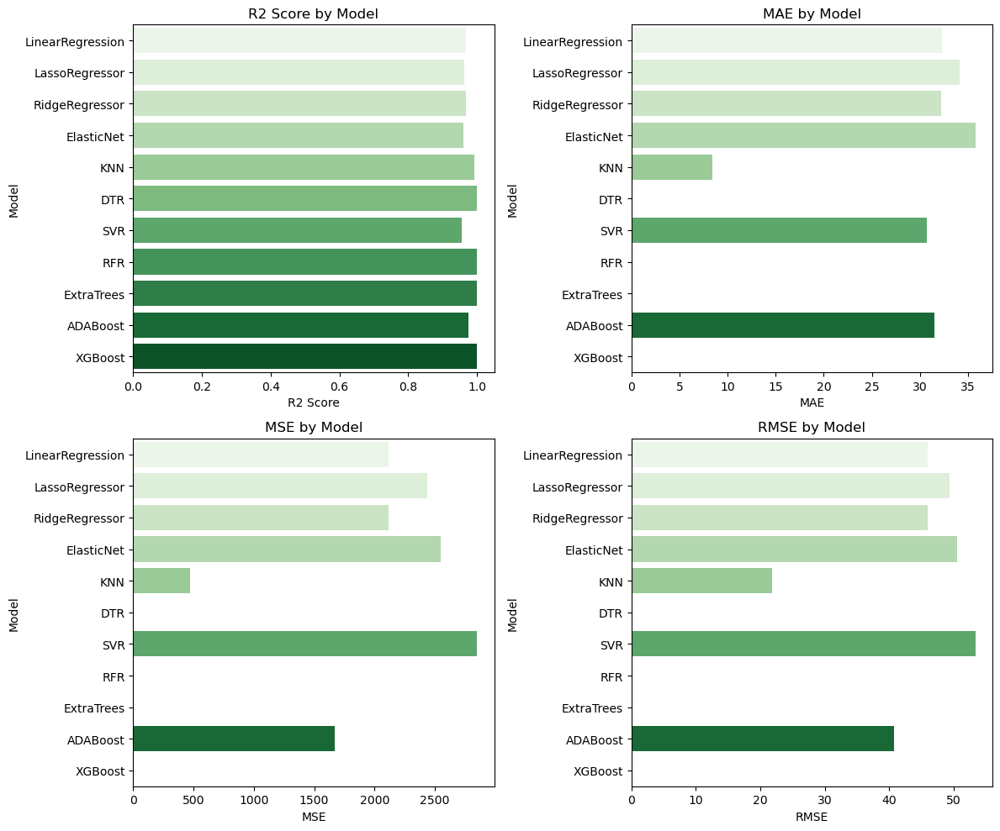

In [63]:
# Plotting evaluation metrics in bar chart:

metrics = ['R2 Score', 'MAE', 'MSE', 'RMSE']
values = [r2_list, mae_list, mse_list, rmse_list]


fig, axes = plt.subplots(2, 2, figsize=(12, 10))

cmap = 'Blues'  

for i, ax in enumerate(axes.flatten()):
    sns.barplot(x=values[i], y=model_list, orient='h', ax=ax, palette='Greens') 
    ax.set_xlabel(metrics[i])
    ax.set_ylabel('Model')
    ax.set_title(f'{metrics[i]} by Model')

plt.tight_layout()
plt.show()

**Result Comparison: RFR Vs Actual Values**

In [64]:
RFR = RandomForestRegressor(random_state=42)
RFR.fit(X_train_transformed, y_train)

RandomForestRegressor(random_state=42)

In [65]:
y_pred =RFR.predict(X_test_transformed)

In [66]:
print(type(y_test))
print(y_test.shape)

print(y_pred.shape)
print(type(y_pred))

<class 'pandas.core.frame.DataFrame'>
(16038, 1)
(16038,)
<class 'numpy.ndarray'>


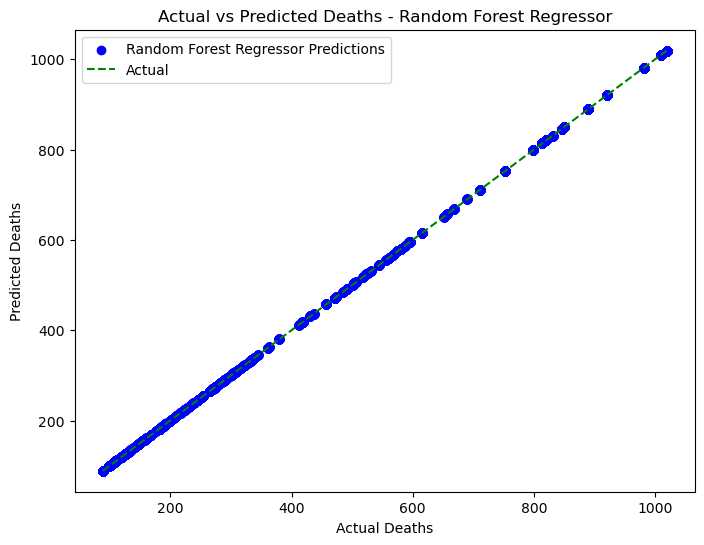

In [67]:
# Convert y_test to a 1D numpy array
y_test = np.array(y_test).flatten()

plt.figure(figsize=(8, 6))
plt.scatter(y_test, y_pred, color='blue', label='Random Forest Regressor Predictions')
plt.plot([min(y_test), max(y_test)], [min(y_test), max(y_test)], '--', color='green', label='Actual')
plt.xlabel('Actual Deaths')
plt.ylabel('Predicted Deaths')
plt.title('Actual vs Predicted Deaths - Random Forest Regressor')
plt.legend()
plt.show()